#Проект по детекции персонажей майнкрафт

учебный проект Yandex Practicum CV Sprint1 содержит

преобразование датасета из формата PASCAL в формат для YOLO и MMDetection,

EDA и перераспределение обучающей-тестовой выборок (в исходном разбиении в валидационной выборке не было нескольких классов, в обучающей один из важных классов был представлен 2 объектами)

Обучение модели в MMdetection ( вынесен в отдельный блокнот с результатами запуска на ВМ)

Обучение модели в YOLO (вынесен в отдельный блокнот с результатами запуска на ВМ)

Инференс моделей на изображениях и видео

Графики по логу обучения в MMDetection и YOLO

PDF-отчет

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
# Check nvcc version
!nvcc -V
# Check GCC version
!gcc --version

/bin/bash: line 1: nvcc: command not found
gcc (Ubuntu 11.4.0-1ubuntu1~22.04.2) 11.4.0
Copyright (C) 2021 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [5]:
!pip install torch torchvision torchaudio

In [5]:
!pip install onedl-mim
!mim install onedl-mmengine

Looking in links: https://mmwheels.onedl.ai/cpu-torch290/simple/onedl-mmcv/index.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 377.3/377.3 kB 21.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.8/46.8 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 256.2/256.2 kB 17.9 MB/s eta 0:00:00
  Created wheel for onedl-mmengine: filename=onedl_mmengine-0.10.9-py3-none-any.whl size=453189 sha256=7bbebb2162a4c754db241192752088e0f36badb0a31e49d32a617415f76131b7
  Stored in directory: /root/.cache/pip/wheels/2f/84/3d/1e8583ddaff95db7ca3cdf0ac6103eff22715c2b7463d92818
Successfully built onedl-mmengine
mim resources not found: /usr/local/lib/python3.12/dist-packages/.mim, you can try to install the latest onedl-mmdetection.


Mim должен скачать подходящий wheel для библиотеки

In [6]:
!mim install onedl-mmcv

Looking in links: https://mmwheels.onedl.ai/cpu-torch290/simple/onedl-mmcv/index.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 32.9/32.9 MB 30.6 MB/s eta 0:00:00
mim resources not found: /usr/local/lib/python3.12/dist-packages/.mim, you can try to install the latest onedl-mmdetection.


In [1]:
!git clone https://github.com/vbti-development/onedl-mmdetection.git
%cd onedl-mmdetection
!pip install -e .

Cloning into 'onedl-mmdetection'...
remote: Enumerating objects: 38541, done.
remote: Counting objects: 100% (545/545), done.
remote: Compressing objects: 100% (257/257), done.
remote: Total 38541 (delta 375), reused 290 (delta 288), pack-reused 37996 (from 3)
Receiving objects: 100% (38541/38541), 70.73 MiB | 18.42 MiB/s, done.
Resolving deltas: 100% (26365/26365), done.
/content/onedl-mmdetection
Obtaining file:///content/onedl-mmdetection
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 961.5/961.5 kB 37.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 76.5 MB/s eta 0:00:00
  Building editable for onedl-mmdetection (pyproject.toml) ... done
  Created wheel for onedl-mmdetection: filename=onedl_mmdetection-3.4.4-0.editable-py3-none-any.whl size=13639 sha256=d5

In [2]:
# установите дополнительные пакеты, которые могут понадобиться при работе
import os
import shutil
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
from PIL import Image
import xml.etree.ElementTree as ET


In [3]:
# Структура проекта:
folders_to_create=[
    'datasets',
    'artifacts',
    'configs/fcos',
    'artifacts/fcos',
    'artifacts/yolo',
    'artifacts/metrics',
    'artifacts/inference/fcos',
    'artifacts/inference/yolo',
    'artifacts/videos',
    'checkpoints',
    'datasets'
]

# Создаём целевые папки, если их нет
for folder in folders_to_create:
  try:
    os.makedirs(folder, exist_ok=True)
  except OSError as e:
    print(f"Error: {e.strerror}. The directory might be in use or you lack permissions.")

In [7]:
import torch
import mmcv
import mmdet
from mmcv.ops import RoIAlign, nms
import numpy as np


print(f"PyTorch Version: {torch.__version__}")
print(f"MMCV Version: {mmcv.__version__}")
print(f"MMDet Version: {mmdet.__version__}")

# Патч для совместимости с pycocotools
if not hasattr(np, 'float'):
    np.float = float
if not hasattr(np, 'int'):
    np.int = int
if not hasattr(np, 'bool'):
    np.bool = bool

print(f"Numpy Version: {np.__version__}")


PyTorch Version: 2.9.0+cpu
MMCV Version: 2.3.2.post2
MMDet Version: 3.4.4
Numpy Version: 2.0.2


In [ ]:
try:
 # Тест импорта реестра моделей
 from mmdet.registry import MODELS
 # Тест импорта реестра метрик
 from mmdet.registry import METRICS
 print("✅ MMDetection Registry working")
except Exception as e:
 print(f"❌ MMDetection Init Failed: {e}")


✅ MMDetection Registry working


In [ ]:
METRICS

Registry of metric 
┏━━━━━━━┳━━━━━━━━━┓
┃ Names ┃ Objects ┃
┡━━━━━━━╇━━━━━━━━━┩
└───────┴─────────┘

In [ ]:
MODELS

 Registry of model 
┏━━━━━━━┳━━━━━━━━━┓
┃ Names ┃ Objects ┃
┡━━━━━━━╇━━━━━━━━━┩
└───────┴─────────┘

Пока библиотека не использовалась, поэтому зарегистрированных моделей и метрик нет. С установленным патчем нет проблем с версией numpy.

Тут дальше при попытке зарегистрировать модели была ошибка:

/content/onedl-mmdetection/mmdet/evaluation/metrics/faster_coco_metric.py in <module>
     11 import numpy as np
     12 import torch
---> 13 from faster_coco_eval import COCO, COCOeval_faster
     14 from mmengine.fileio import load
     15 from mmengine.logging import MMLogger

ModuleNotFoundError: No module named 'faster_coco_eval'


Если была ошибка ModuleNotFoundError: No module named 'faster_coco_eval', то установим пакет faster_coco_eval, или как вариант можно закоментить строку 13 в /content/onedl-mmdetection/mmdet/evaluation/metrics/faster_coco_metric.py.

Просто инференс работает и так и так.

In [14]:
!pip install faster_coco_eval

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 585.6/585.6 kB 30.6 MB/s eta 0:00:00


# Интеференс модели в MMDetection. Пример из урока

Проверка тестового изображения

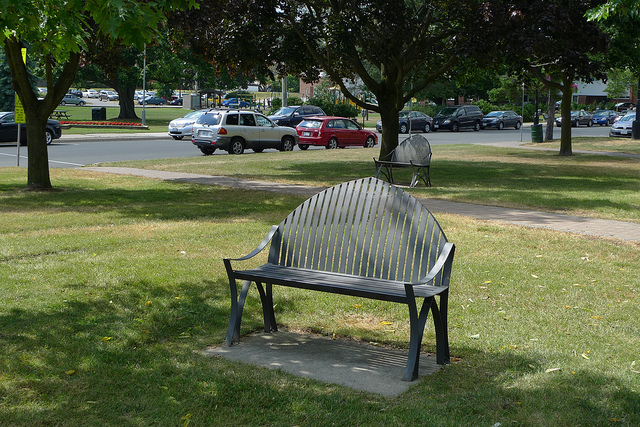

In [ ]:
# Show the output image
from PIL import Image
Image.open('./demo/demo.jpg')

In [ ]:
!mim download onedl-mmdetection --config rtmdet_tiny_8xb32-300e_coco --dest ./checkpoints

processing rtmdet_tiny_8xb32-300e_coco...
downloading ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.9/54.9 MiB 30.3 MB/s eta 0:00:00
Successfully downloaded rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth to /content/onedl-mmdetection/checkpoints
Successfully dumped rtmdet_tiny_8xb32-300e_coco.py to /content/onedl-mmdetection/checkpoints


Проверим с тем файлом, который скачивали

Could not import OneDL


/usr/local/lib/python3.12/dist-packages/imagecorruptions/corruptions.py:15: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  from pkg_resources import resource_filename


Could not import OneDL
Loads checkpoint by local backend from path: ./checkpoints/rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth
Could not safely load weights: Weights only load failed. This file can still be loaded, to do so you have two options, do those steps only if you trust the source of the checkpoint. 
	(1) In PyTorch 2.6, we changed the default value of the `weights_only` argument in `torch.load` from `False` to `True`. Re-running `torch.load` with `weights_only` set to `False` will likely succeed, but it can result in arbitrary code execution. Do it only if you got the file from a trusted source.
	(2) Alternatively, to load with `weights_only=True` please check the recommended steps in the following error message.
	WeightsUnpickler error: Unsupported global: GLOBAL numpy.core.multiarray._reconstruct was not an allowed global by default. Please use `torch.serialization.add_safe_globals([numpy.core.multiarray._reconstruct])` or the `torch.serialization.safe_globals([n

/content/onedl-mmdetection/mmdet/models/backbones/trident_resnet.py:244: SyntaxWarning: invalid escape sequence '\ '
  \ stage3(b2) /
/content/onedl-mmdetection/mmdet/models/dense_heads/free_anchor_retina_head.py:290: SyntaxWarning: invalid escape sequence '\i'
  :math:`FL((1 - P_{a_{j} \in A_{+}}) * (1 - P_{j}^{bg}))`.


The model and loaded state dict do not match exactly

unexpected key in source state_dict: data_preprocessor.mean, data_preprocessor.std

01/14 15:30:02 - mmengine - WARNING - Failed to search registry with scope "mmdet" in the "function" registry tree. As a workaround, the current "function" registry in "mmengine" is used to build instance. This may cause unexpected failure when running the built modules. Please check whether "mmdet" is a correct scope, or whether the registry is initialized.


Output()

/usr/local/lib/python3.12/dist-packages/mmengine/visualization/visualizer.py:196: UserWarning: Failed to add <class 'mmengine.visualization.vis_backend.LocalVisBackend'>, please provide the `save_dir` argument.
  warnings.warn(f'Failed to add {vis_backend.__class__}, '


/content/onedl-mmdetection/mmdet/models/layers/se_layer.py:158: FutureWarning: `torch.cuda.amp.autocast(args...)` 
is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=False):

/content/onedl-mmdetection/mmdet/models/backbones/csp_darknet.py:118: FutureWarning: 
`torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=False):

/usr/local/lib/python3.12/dist-packages/torch/functional.py:505: UserWarning: torch.meshgrid: in an upcoming 
release, it will be required to pass the indexing argument. (Triggered internally at 
/pytorch/aten/src/ATen/native/TensorShape.cpp:4317.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]

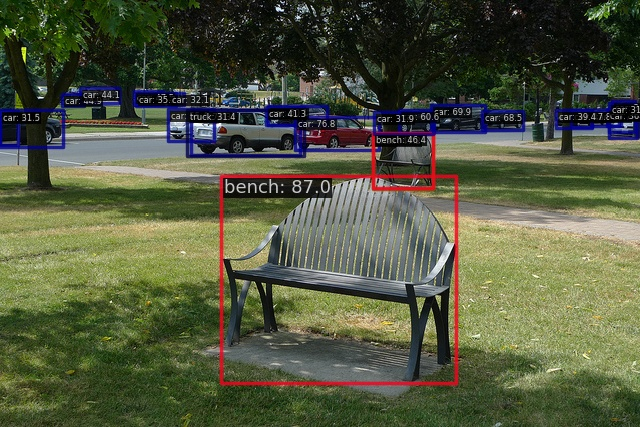

In [ ]:
from PIL import Image
from mmdet.apis import DetInferencer

# Choose to use a config
config_path = './configs/rtmdet/rtmdet_tiny_8xb32-300e_coco.py' # внезапно это другой файл, а не тот, что скачивали

#config_path = './checkpoints/rtmdet_tiny_8xb32-300e_coco.py' # файл, что скачивали вместе с весами

# Setup a checkpoint file to load
checkpoint = './checkpoints/rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth'

# Initialize the DetInferencer
inferencer = DetInferencer(model=config_path, weights=checkpoint)

# Perform inference
inferencer('demo/demo.jpg', out_dir='./output/rtmdet')
Image.open('./output/rtmdet/vis/demo.jpg')

Скачиваем веса для модели из проекта

In [ ]:
!mim download onedl-mmdetection --config fcos_r50-caffe_fpn_gn-head_1x_coco --dest ./checkpoints

processing fcos_r50-caffe_fpn_gn-head_1x_coco...
downloading ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 123.5/123.5 MiB 34.4 MB/s eta 0:00:00
Successfully downloaded fcos_r50_caffe_fpn_gn-head_1x_coco-821213aa.pth to /content/onedl-mmdetection/checkpoints
Successfully dumped fcos_r50-caffe_fpn_gn-head_1x_coco.py to /content/onedl-mmdetection/checkpoints


Loads checkpoint by local backend from path: ./checkpoints/fcos_r50_caffe_fpn_gn-head_1x_coco-821213aa.pth


Output()

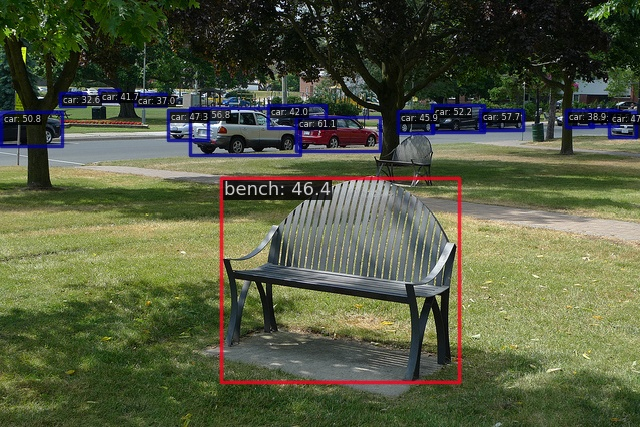

In [ ]:
from PIL import Image
from mmdet.apis import DetInferencer

# Choose to use a config
config_path = './checkpoints/fcos_r50-caffe_fpn_gn-head_1x_coco.py' # внезапно файл, который скачивали вместе с весами

# Setup a checkpoint file to load
checkpoint = './checkpoints/fcos_r50_caffe_fpn_gn-head_1x_coco-821213aa.pth'

# Initialize the DetInferencer
inferencer = DetInferencer(model=config_path, weights=checkpoint)

# Perform inference
inferencer('demo/demo.jpg', out_dir='./output/fcos')
Image.open('./output/fcos/vis/demo.jpg')

Запишем свой конфиг на основе примера с onedl-mmdetection.git для обучения на основе FCOS

In [ ]:
fcos_config = f'''
_base_ = [
    '../_base_/datasets/coco_detection.py',
    '../_base_/schedules/schedule_1x.py',
    '../_base_/default_runtime.py'
]

# Модель
model = dict(
    type='FCOS',
    data_preprocessor=dict(
        type='DetDataPreprocessor',
        mean=[103.530, 116.280, 123.675],
        std=[1.0, 1.0, 1.0],
        bgr_to_rgb=False,
        pad_size_divisor=32),
    backbone=dict(
        type='ResNet',
        depth=50,
        num_stages=4,
        out_indices=(0, 1, 2, 3),
        frozen_stages=1,
        norm_cfg=dict(type='BN', requires_grad=False),
        norm_eval=True,
        style='caffe',
        init_cfg=dict(
            type='Pretrained',
            checkpoint='open-mmlab://detectron2/resnet50_caffe')),
    neck=dict(
        type='FPN',
        in_channels=[256, 512, 1024, 2048],
        out_channels=256,
        start_level=1,
        add_extra_convs='on_output',
        num_outs=5,
        relu_before_extra_convs=True),
   bbox_head=dict(
        type='FCOSHead',
        num_classes=80,
        in_channels=256,
        stacked_convs=4,
        feat_channels=256,
        strides=[8, 16, 32, 64, 128],
        loss_cls=dict(
            type='FocalLoss',
            use_sigmoid=True,
            gamma=2.0,
            alpha=0.25,
            loss_weight=1.0),
        loss_bbox=dict(type='IoULoss', loss_weight=1.0),
        loss_centerness=dict(
            type='CrossEntropyLoss', use_sigmoid=True, loss_weight=1.0)),
 # testing settings
 test_cfg=dict(
        nms_pre=1000,
        min_bbox_size=0,
        score_thr=0.05,
        nms=dict(type='nms', iou_threshold=0.5),
        max_per_img=100))

# Данные
data_root = 'datasets/minecraft/'

train_dataloader = dict(
    batch_size=2,
    num_workers=2,
    dataset=dict(
        data_root=data_root,
        ann_file='annotations/train.json',
        data_prefix=dict(img='train/'),
        pipeline=[
            dict(type='LoadImageFromFile'),
            dict(type='LoadAnnotations', with_bbox=True),
            dict(type='Resize', scale=(512, 512), keep_ratio=True),
            dict(type='RandomFlip', prob=0.5),
            dict(type='PackDetInputs')
        ]))

val_dataloader = dict(
    batch_size=2,
    num_workers=2,
    dataset=dict(
        data_root=data_root,
        ann_file='annotations/val.json',
        data_prefix=dict(img='val/'),
        pipeline=[
            dict(type='LoadImageFromFile'),
            dict(type='Resize', scale=(512, 512), keep_ratio=False),
            dict(type='LoadAnnotations', with_bbox=True),
            dict(type='PackDetInputs')
        ]))

test_dataloader = val_dataloader

# Оценка
val_evaluator = dict(
    type='CocoMetric',
    ann_file=data_root + 'annotations/val.json',
    metric='bbox',
    format_only=False)
test_evaluator = val_evaluator

# Обучение
train_cfg = dict(type='EpochBasedTrainLoop', max_epochs=2, val_interval=1)
val_cfg = dict(type='ValLoop')
test_cfg = dict(type='TestLoop')

# Оптимизатор
optim_wrapper = dict(
    type='OptimWrapper',
    optimizer=dict(type='SGD', lr=0.001, momentum=0.9, weight_decay=0.0001))

# Планировщик
param_scheduler = [
    dict(type='LinearLR', start_factor=0.001, by_epoch=False, begin=0, end=500),
    dict(type='MultiStepLR', by_epoch=True, milestones=[8, 11], gamma=0.1)
]

# Чекпоинты
default_hooks = dict(
    checkpoint=dict(type='CheckpointHook', interval=1, max_keep_ckpts=3),
    logger=dict(type='LoggerHook', interval=50))

# FP16
fp16 = dict(loss_scale='dynamic')
'''

with open('configs/fcos/fcos_minecraft.py', 'w') as f:
    f.write(fcos_config)


Loads checkpoint by local backend from path: ./checkpoints/fcos_r50_caffe_fpn_gn-head_1x_coco-821213aa.pth


Output()

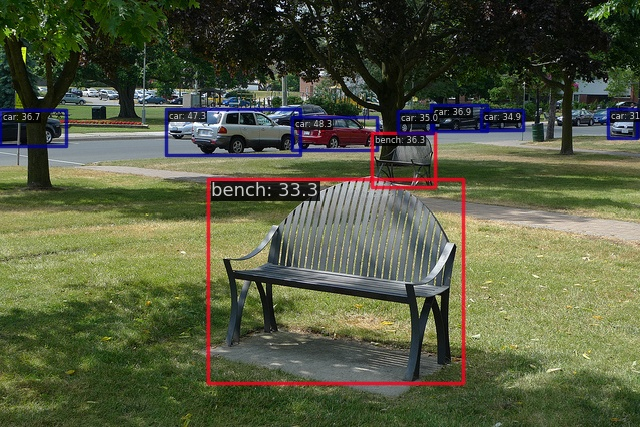

In [ ]:
from PIL import Image
from mmdet.apis import DetInferencer

# Choose to use a config
config_path = './configs/fcos/fcos_minecraft.py' # внезапно файл, который сочинили
# config_path = './configs/fcos/fcos_r50-caffe_fpn_gn-head_1x_coco.py' # test


# Setup a checkpoint file to load
checkpoint = './checkpoints/fcos_r50_caffe_fpn_gn-head_1x_coco-821213aa.pth'

# Initialize the DetInferencer
inferencer = DetInferencer(model=config_path, weights=checkpoint)

# Perform inference
inferencer('demo/demo.jpg', out_dir='./output/fcos_minecraft')
Image.open('./output/fcos_minecraft/vis/demo.jpg')

Качество упало. Рамка больше и уверенности меньше. Разница только в размере img_scale 512х512 вместо 1333х800 и keep_ratio=False. Размер 512 рекомендован в инструкции к проекту. Вернула бы обратно keep_ratio=True, по факту он дает тут результат увереннее, 42% вместо 33%. Так как веса соответствуют обучению с keep_ratio=True.

Конфиг можно смотреть и редактировать по частям

In [ ]:
from mmengine.config import Config

# Загружаем конфиг и поменяем test_dataloader
config_file = 'configs/fcos/fcos_minecraft.py'
cfg = Config.fromfile(config_file)
cfg.test_dataloader.dataset.pipeline=[{'type': 'LoadImageFromFile'},
 {'type': 'Resize', 'scale': (512, 512), 'keep_ratio': True},
 {'type': 'LoadAnnotations', 'with_bbox': True},
 {'type': 'PackDetInputs'}]

cfg.test_dataloader.dataset.pipeline


[{'type': 'LoadImageFromFile'},
 {'type': 'Resize', 'scale': (512, 512), 'keep_ratio': True},
 {'type': 'LoadAnnotations', 'with_bbox': True},
 {'type': 'PackDetInputs'}]

Loads checkpoint by local backend from path: ./checkpoints/fcos_r50_caffe_fpn_gn-head_1x_coco-821213aa.pth


Output()

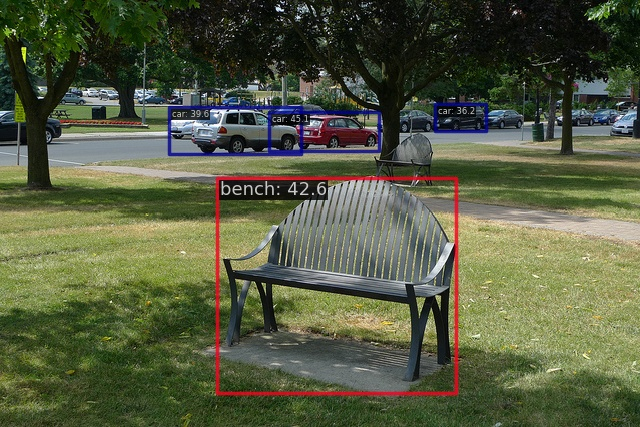

In [ ]:
# Initialize the DetInferencer
inferencer = DetInferencer(cfg, weights=checkpoint)

# Perform inference
inferencer('demo/demo.jpg', out_dir='./output/fcos_minecraft_keep_ratio')
Image.open('./output/fcos_minecraft_keep_ratio/vis/demo.jpg')

Еще можно, например, изменить с дефолтной директорию для сохранения checkpoint

In [ ]:
cfg.default_hooks.checkpoint.out_dir = 'artifacts/fcos'
cfg.default_hooks.checkpoint

{'type': 'CheckpointHook',
 'interval': 1,
 'max_keep_ckpts': 3,
 'out_dir': 'artifacts/fcos'}

# Скачивание и распаковка minecraft.zip

Скачаем архив с диска и разархивируем

In [18]:
cd ..

/content


In [19]:
import shutil
shutil.copyfile('/content/drive/MyDrive/Minecraft_Mob_Detection.zip','/content/minecraft.zip')

'/content/minecraft.zip'

In [20]:
!unzip minecraft.zip

Выходные данные были обрезаны до нескольких последних строк (5000).
  inflating: Minecraft Mob Detection/valid/tree-extracted00017_png.rf.6c0c68bdbeccdcab94c24056233ee3a5.xml  
  inflating: Minecraft Mob Detection/valid/creeper00045_png.rf.004411ffbc47e67cc4e3b9d561d5a9be.xml  
  inflating: Minecraft Mob Detection/valid/creeper00045_png.rf.004411ffbc47e67cc4e3b9d561d5a9be.jpg  
  inflating: Minecraft Mob Detection/valid/tree-extracted00017_png.rf.6c0c68bdbeccdcab94c24056233ee3a5.jpg  
  inflating: Minecraft Mob Detection/valid/creeper00020_png.rf.b6b0726c6ebde62a481f36526592e4d2.jpg  
  inflating: Minecraft Mob Detection/valid/enderman-98-_png.rf.6dcc7a2d8202141ad6880d3b6ee4895e.xml  
  inflating: Minecraft Mob Detection/valid/Minecraft-1-19-2-2022-11-29-4_04_19_png.rf.a38fac5366ef5fb2979a46cd7a97d07e.xml  
  inflating: Minecraft Mob Detection/valid/creeper-29-_png.rf.26b02c7f157e7f11488003d3074a7d46.xml  
  inflating: Minecraft Mob Detection/valid/creeper-29-_png.rf.26b02c7f157e7f1148

Просили положить в папку 'datasets/minecraft'

In [21]:
cd /content/onedl-mmdetection

/content/onedl-mmdetection


In [22]:
import shutil
import os

dataset_dir='/content/onedl-mmdetection/datasets/minecraft'#/content/Minecraft Mob Detection

try:
    #shutil.rmtree(dataset_dir)
    os.rename('/content/Minecraft Mob Detection',dataset_dir)
    print(f"Directory '{dataset_dir}' and all its contents replaced successfully.")
except OSError as e:
    print(f"Error: {e.strerror}. The directory might be in use or you lack permissions.")

Error: Directory not empty. The directory might be in use or you lack permissions.


Преобразуем датасет к требуемому виду. Структура должна быть изменена в соответствии с требованиями проекта.

In [ ]:
# Структура проекта
images_folder='datasets/minecraft/images'
labels_folder='datasets/minecraft/labels'
annotations_folder='datasets/minecraft/annotations'
folders_to_create = [images_folder, labels_folder,annotations_folder]
# по три папки избражений, разметки и аннотаций

image_folders=[]
label_folders=[]
json_paths=[]

for split in ['train','val','test']:
   image_path = os.path.join(images_folder, split)
   image_folders.append(image_path)
   label_path = os.path.join(labels_folder, split)
   label_folders.append(label_path)
   json_path=os.path.join(annotations_folder, split+'.json')
   json_paths.append(json_path)

json_paths

['datasets/minecraft/annotations/train.json',
 'datasets/minecraft/annotations/val.json',
 'datasets/minecraft/annotations/test.json']

In [ ]:
folders_to_create= folders_to_create + image_folders+ label_folders
folders_to_create

['datasets/minecraft/images',
 'datasets/minecraft/labels',
 'datasets/minecraft/annotations',
 'datasets/minecraft/images/train',
 'datasets/minecraft/images/val',
 'datasets/minecraft/images/test',
 'datasets/minecraft/labels/train',
 'datasets/minecraft/labels/val',
 'datasets/minecraft/labels/test']

In [ ]:
# Структура датасета:
# по три папки избражений и разметки и одна аннотаций
# Создаём целевые папки, если их нет
for folder in folders_to_create:
  try:
    os.makedirs(folder, exist_ok=True)
  except OSError as e:
    print(f"Error: {e.strerror}. The directory might be in use or you lack permissions.")


In [ ]:
image_folder_train='datasets/minecraft/train';
image_folder_valid='datasets/minecraft/valid';
image_folder_test='datasets/minecraft/test';
old_image_folders = [image_folder_train, image_folder_valid, image_folder_test]

for old_image_folder,imag_folder in zip(old_image_folders,image_folders):
  try:
      os.rename(old_image_folder,imag_folder)
  except OSError as e:
    print(f"Error: {e.strerror}. The directory might be in use or you lack permissions.")


# Исследовательский анализ (EDA) и работа с данными

In [23]:
# Словарь классов
cls_names=['bee', 'chicken', 'cow', 'creeper', 'enderman', 'fox', 'frog', 'ghast',
'goat', 'llama', 'pig', 'sheep', 'skeleton', 'spider', 'turtle', 'wolf', 'zombie' ]
keys = cls_names
cls_dict = dict(zip(keys, list(range(len(keys)))))
cls_dict

{'bee': 0,
 'chicken': 1,
 'cow': 2,
 'creeper': 3,
 'enderman': 4,
 'fox': 5,
 'frog': 6,
 'ghast': 7,
 'goat': 8,
 'llama': 9,
 'pig': 10,
 'sheep': 11,
 'skeleton': 12,
 'spider': 13,
 'turtle': 14,
 'wolf': 15,
 'zombie': 16}

In [ ]:
image_folders

['datasets/minecraft/images/train',
 'datasets/minecraft/images/val',
 'datasets/minecraft/images/test']

In [ ]:
# Функция для чтения координат  и класса из .xml файла
def parse_annotation(xml_file,cls_dict):
    tree = ET.parse(xml_file)
    root = tree.getroot()
    boxes = []
    imag_prop= root.find('size')
    width = int(imag_prop.find('width').text)
    height = int(imag_prop.find('height').text)

    for obj in root.findall('object'):
        class_name = obj.find('name').text
        bbox = obj.find('bndbox')
        xmin = int(bbox.find('xmin').text)
        ymin = int(bbox.find('ymin').text)
        xmax = int(bbox.find('xmax').text)
        ymax = int(bbox.find('ymax').text)
        boxes.append((cls_dict[class_name],xmin, ymin, xmax, ymax,width,height))

    return boxes


In [ ]:
# Функция для отображения изображения с нанесенными на него пикетами
def show_image_with_boxes(image_path, boxes,savefig=False, file_name='test.jpg'):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Для корректного отображения цветов

    for (cls, xmin, ymin, xmax, ymax,width,height) in boxes:
        class_name=cls_names[cls]
        cv2.rectangle(image, (xmin, ymin), (xmax, ymax), (255, 0, 0), 3)  # Отрисовка красных рамок вокруг пикетов
        cv2.putText(image, class_name, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)

    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.axis('off')
    if savefig:
      plt.savefig(file_name, dpi=300, bbox_inches='tight');
    plt.show()


In [ ]:
import xml.etree.ElementTree as ET

# image_folders - три папки избражений
# Проверка соответствия изображений и аннотаций
all_boxes=[]
for image_folder in image_folders:
    annotation_folder=image_folder #'data' #'annotations'
    # Получение списка всех изображений и соответствующих xml файлов
    images = [f for f in os.listdir(image_folder) if f.endswith(('.jpg', '.png'))]
    annotations = [f.replace('.jpg', '.xml') for f in images]

    folder_boxes=[]
    # чтение координат и класса из .xml файла
    for image_file in images:
        annotation=image_file.replace('.jpg', '.xml')
        annotation=annotation.replace('.png', '.xml')
        image_path = os.path.join(image_folder, image_file)
        annotation_path = os.path.join(annotation_folder, annotation)

        if os.path.exists(annotation_path):
            file_boxes = parse_annotation(annotation_path,cls_dict)
            folder_boxes.append([file_boxes,image_path])
        else:
            print(f"Разметка для изображения {image_path} не найдена. Изображение удалено.")
            os.remove(image_path)

    print(f"Разметка для папки {image_folder} найдено {len(folder_boxes)} файла.")
    all_boxes.append(folder_boxes)

Разметка для изображения datasets/minecraft/images/train/2023-04-03_19_17_30_png.rf.8ca8dad6210d53c762b3b8df9bbb5db2.jpg не найдена. Изображение удалено.
Разметка для изображения datasets/minecraft/images/train/Screenshot-188-_png.rf.7990d49953d8657dda9da38d1c75749a.jpg не найдена. Изображение удалено.
Разметка для папки datasets/minecraft/images/train найдено 2305 файла.
Разметка для папки datasets/minecraft/images/val найдено 422 файла.
Разметка для папки datasets/minecraft/images/test найдено 155 файла.


In [ ]:
# всего файлов
total_images = sum([len(folder_boxes) for folder_boxes in all_boxes])
total_images

2882

In [ ]:
# разбиение файлов на папки в процентах
for image_folder,folder_boxes in zip(image_folders,all_boxes):
    print(f"Доля файлов в папке {image_folder} от общего числа файлов {100*len(folder_boxes)/total_images:.1f}%.")


Доля файлов в папке datasets/minecraft/images/train от общего числа файлов 80.0%.
Доля файлов в папке datasets/minecraft/images/val от общего числа файлов 14.6%.
Доля файлов в папке datasets/minecraft/images/test от общего числа файлов 5.4%.


Процентное соотношение количества картинок стандарно.

Проверим количество объектов разных классов. Отдельно посчитаем файлы, в которых объекты нескольких классов

In [ ]:
def prepear_hist(folderboxes,cls_dict,one_per_file=False):
    clss=[]
    for (boxes,file_name) in folderboxes:
        box_clss=[]
        for (cls, xmin, ymin, xmax, ymax, width, height) in boxes:
            box_clss.append(cls)
        if(not one_per_file or len(set(box_clss))==1):
            for x in set(box_clss):
                clss.append(x)

    hist=[]
    for n in range( len(cls_dict)):
        hist.append(sum([1 for x in clss if x==n]))

    return hist


In [ ]:
hist_train= prepear_hist(all_boxes[0],cls_dict,one_per_file=False)
hist_train1= prepear_hist(all_boxes[0],cls_dict,one_per_file=True)
list(zip(range(len(cls_names)),cls_names,hist_train,hist_train1)),sum(hist_train),sum(hist_train1)

([(0, 'bee', 84, 76),
  (1, 'chicken', 465, 421),
  (2, 'cow', 274, 218),
  (3, 'creeper', 106, 93),
  (4, 'enderman', 21, 19),
  (5, 'fox', 105, 66),
  (6, 'frog', 106, 73),
  (7, 'ghast', 110, 107),
  (8, 'goat', 97, 87),
  (9, 'llama', 130, 110),
  (10, 'pig', 375, 328),
  (11, 'sheep', 57, 6),
  (12, 'skeleton', 157, 119),
  (13, 'spider', 163, 138),
  (14, 'turtle', 140, 120),
  (15, 'wolf', 2, 1),
  (16, 'zombie', 167, 129)],
 2559,
 2111)

В табличке можно видеть количество картинок с объектами каждого класса и число картинок, где этот класс единственный. Так, например, мы видим, что волк присутствует в обучающей выборке в минимальном количестве (один файл с классом волк и еще один, где кроме волка есть еще объект другого класса).

Посмотрим на выборку для валидации

In [ ]:
hist_valid= prepear_hist(all_boxes[1],cls_dict,one_per_file=False)
hist_valid1= prepear_hist(all_boxes[1],cls_dict,True)
list(zip(range(len(cls_names)),cls_names,hist_valid,hist_valid1)),sum(hist_valid),sum(hist_valid1)

([(0, 'bee', 0, 0),
  (1, 'chicken', 10, 0),
  (2, 'cow', 88, 36),
  (3, 'creeper', 123, 90),
  (4, 'enderman', 103, 93),
  (5, 'fox', 0, 0),
  (6, 'frog', 0, 0),
  (7, 'ghast', 0, 0),
  (8, 'goat', 0, 0),
  (9, 'llama', 0, 0),
  (10, 'pig', 40, 0),
  (11, 'sheep', 68, 39),
  (12, 'skeleton', 7, 4),
  (13, 'spider', 8, 4),
  (14, 'turtle', 0, 0),
  (15, 'wolf', 85, 64),
  (16, 'zombie', 1, 0)],
 533,
 330)

В папке для валидации нет картинок с классами пчела, лиса и др. Зато много волков.

In [ ]:
hist_test= prepear_hist(all_boxes[2],cls_dict,one_per_file=False)
hist_test1= prepear_hist(all_boxes[2],cls_dict,one_per_file=True)
list(zip(range(len(cls_names)),cls_names,hist_test,hist_test1)),sum(hist_test),sum(hist_test1)

([(0, 'bee', 0, 0),
  (1, 'chicken', 5, 0),
  (2, 'cow', 10, 4),
  (3, 'creeper', 17, 16),
  (4, 'enderman', 2, 2),
  (5, 'fox', 0, 0),
  (6, 'frog', 0, 0),
  (7, 'ghast', 0, 0),
  (8, 'goat', 0, 0),
  (9, 'llama', 0, 0),
  (10, 'pig', 80, 76),
  (11, 'sheep', 43, 34),
  (12, 'skeleton', 4, 2),
  (13, 'spider', 7, 6),
  (14, 'turtle', 0, 0),
  (15, 'wolf', 0, 0),
  (16, 'zombie', 2, 0)],
 170,
 140)

Аналогично, в тестовой выборке отсутствуют некоторые классы, например, нет пчел и лис.

In [ ]:
sum_all=sum([sum(hist_train),sum(hist_valid),sum(hist_test)])
print(f"Всего объектов в датасете: ", sum_all)
print(f"Доля объектов в папках")
[sum(hist_train)/sum_all,sum(hist_valid)/sum_all,sum(hist_test)/sum_all]

Всего объектов в датасете:  3262
Доля объектов в папках


[0.7844880441446965, 0.16339668914776212, 0.05211526670754139]

Процентное соотношение количества объектов в выборках стандарно.

In [ ]:
hist_all = np.array(hist_train)+np.array(hist_valid)+np.array(hist_test)
hist_all

array([ 84, 480, 372, 246, 126, 105, 106, 110,  97, 130, 495, 168, 168,
       178, 140,  87, 170])

In [ ]:
hist_all1 = np.array(hist_train1)+np.array(hist_valid1)+np.array(hist_test1)
hist_all1

array([ 76, 421, 258, 199, 114,  66,  73, 107,  87, 110, 404,  79, 125,
       148, 120,  65, 129])

In [ ]:
print('Баланс классов по всему датасету')
print('класс с минимальным числом файлов', cls_names[np.argmin(hist_all)],int(min(hist_all)))
print('класс с максимальным числом файлов',cls_names[np.argmax(hist_all)],int(max(hist_all)))
print('Дисбаланс классов', float(max(hist_all)/min(hist_all)))

Баланс классов по всему датасету
класс с минимальным числом файлов bee 84
класс с максимальным числом файлов pig 495
Дисбаланс классов 5.892857142857143


In [ ]:
print('Баланс классов по картинкам с 1 классом')
print('класс с минимальным числом файлов', cls_names[np.argmin(hist_all1)],int(min(hist_all1)))
print('класс с максимальным числом файлов',cls_names[np.argmax(hist_all1)],int(max(hist_all1)))
print('Дисбаланс классов', float(max(hist_all1)/min(hist_all1)))

Баланс классов по картинкам с 1 классом
класс с минимальным числом файлов wolf 65
класс с максимальным числом файлов chicken 421
Дисбаланс классов 6.476923076923077


Более наглядно на графике количество объектов по классам

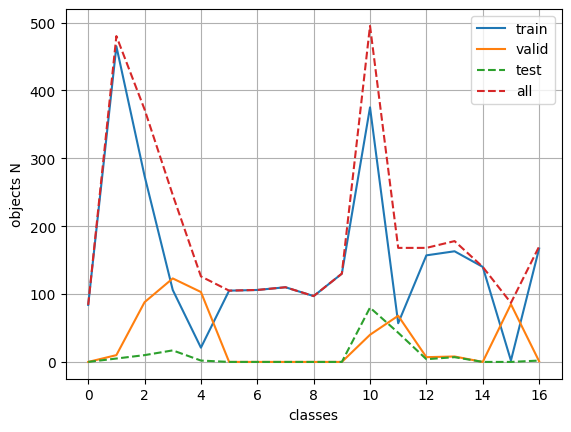

In [ ]:
import matplotlib.pyplot as plt
plt.plot(range(17),hist_train,range(17),hist_valid,range(17),hist_test,'--',hist_all,'--');
plt.legend(['train', 'valid', 'test', 'all'])
plt.grid()
plt.xlabel('classes')
plt.ylabel('objects N');
plt.savefig('artifacts/eda_1.jpg', dpi=300, bbox_inches='tight')

Количество объектов разных классов в целом датасете имеет небольшой дисбаланс,но не является проблемой для обучения. Настоящая проблема - дисбаланс по выборкам.

Пропорциональное деление моноклассовых файлов исправит этот перекос.

Пропорциональное деление моноклассовых файлов 80:15:5 даст в валидационную выборку минимум по 9 файлов, и по 3 в тестовую (65*0.05=3.25).Таким образом, дисбаланс будет устранен.

In [ ]:
# Функция для переноса списка файлов из папки в папку
def move_to_foder(images,folder_from,folder_to):
    if not os.path.exists(folder_to):
        os.mkdir(folder_to)
    for image in images:
        path_from = os.path.join(folder_from, image)
        path_to = os.path.join(folder_to, image)
        try:
            os.rename(path_from, path_to)
        except:
            print(f"Ошибка при работе с файлом {path_from}")

# Функция для переноса файлов изображения и аннотации из папки в папку
def move_file_with_label(file_from, file_to):
    annotation_from = file_from.replace('.jpg', '.xml')
    annotation_to = file_to.replace('.jpg', '.xml')
    try:
        os.rename(file_from, file_to)
    except:
        print(f"Ошибка при работе с файлом {file_from}")
    try:
        os.rename(annotation_from, annotation_to)
    except:
        print(f"Ошибка при работе с файлом {annotation_from}")


In [ ]:
files=[]
for folder_boxes in all_boxes:
    for (boxes,file_name) in folder_boxes:
        box_clss=set([cls for (cls, xmin, ymin, xmax, ymax, width, height) in boxes])
        if(len(box_clss)>1):
               files.append(file_name)

for i_cls in range(len(cls_names)):
    for folder_boxes in all_boxes:
        for (boxes,file_name) in folder_boxes:
            box_clss=set([cls for (cls, xmin, ymin, xmax, ymax, width, height) in boxes])
            if(i_cls in box_clss and len(box_clss)==1):
                files.append(file_name)
len(files)

2882

Перераспределим файлы по папкам (было 2305, 422, 155)

In [ ]:
image_folder_train=image_folders[0];
image_folder_valid=image_folders[1];
image_folder_test=image_folders[2];
image_folder_valid

'datasets/minecraft/images/val'

In [ ]:
files_valid=files[0::5];
files_train = [x for x in files if x not in files_valid]
files_test=files_valid[0::4];
files_valid=[x for x in files_valid if x not in files_test]
len(files_train), len(files_valid),len(files_test)

(2305, 432, 145)

In [ ]:
files_train_to= [f.replace(image_folder_valid, image_folder_train) for f in files_train]
files_train_to= [f.replace(image_folder_test, image_folder_train) for f in files_train_to]
for file_from, file_to in zip(files_train, files_train_to):
    move_file_with_label(file_from, file_to)

files_valid_to= [f.replace(image_folder_train, image_folder_valid) for f in files_valid]
files_valid_to= [f.replace(image_folder_test, image_folder_valid) for f in files_valid_to]
for file_from, file_to in zip(files_valid, files_valid_to):
    move_file_with_label(file_from, file_to)

files_test_to= [f.replace(image_folder_valid, image_folder_test) for f in files_test]
files_test_to= [f.replace(image_folder_train, image_folder_test) for f in files_test_to]

for file_from, file_to in zip(files_test, files_test_to):
    move_file_with_label(file_from, file_to)

In [ ]:
import xml.etree.ElementTree as ET

# image_folders - три папки избражений
# Проверка соответствия изображений и аннотаций
all_boxes=[]
for image_folder in image_folders:
    annotation_folder=image_folder #'data' #'annotations'
    # Получение списка всех изображений и соответствующих xml файлов
    images = [f for f in os.listdir(image_folder) if f.endswith(('.jpg', '.png'))]
    annotations = [f.replace('.jpg', '.xml') for f in images]

    folder_boxes=[]
    # чтение координат и класса из .xml файла
    for image_file in images:
        annotation=image_file.replace('.jpg', '.xml')
        annotation=annotation.replace('.png', '.xml')
        image_path = os.path.join(image_folder, image_file)
        annotation_path = os.path.join(annotation_folder, annotation)

        if os.path.exists(annotation_path):
            file_boxes = parse_annotation(annotation_path,cls_dict)
            folder_boxes.append([file_boxes,image_path])
        else:
            print(f"Разметка для изображения {image_path} не найдена. Изображение удалено.")
            os.remove(image_path)

    print(f"Разметка для папки {image_folder} найдено {len(folder_boxes)} файла.")
    all_boxes.append(folder_boxes)

Разметка для папки datasets/minecraft/images/train найдено 2305 файла.
Разметка для папки datasets/minecraft/images/val найдено 432 файла.
Разметка для папки datasets/minecraft/images/test найдено 145 файла.


In [ ]:
hist_train= prepear_hist(all_boxes[0],cls_dict,one_per_file=False)
hist_train1= prepear_hist(all_boxes[0],cls_dict,one_per_file=True)
list(zip(range(len(cls_names)),cls_names,hist_train,hist_train1)),sum(hist_train),sum(hist_train1)

([(0, 'bee', 65, 61),
  (1, 'chicken', 387, 337),
  (2, 'cow', 295, 206),
  (3, 'creeper', 199, 160),
  (4, 'enderman', 102, 91),
  (5, 'fox', 86, 53),
  (6, 'frog', 83, 58),
  (7, 'ghast', 88, 86),
  (8, 'goat', 77, 69),
  (9, 'llama', 104, 88),
  (10, 'pig', 396, 323),
  (11, 'sheep', 138, 64),
  (12, 'skeleton', 135, 100),
  (13, 'spider', 144, 118),
  (14, 'turtle', 112, 96),
  (15, 'wolf', 70, 52),
  (16, 'zombie', 131, 103)],
 2612,
 2065)

In [ ]:
hist_valid= prepear_hist(all_boxes[1],cls_dict,one_per_file=False)
hist_valid1= prepear_hist(all_boxes[1],cls_dict,True)
list(zip(range(len(cls_names)),cls_names,hist_valid,hist_valid1)),sum(hist_valid),sum(hist_valid1)

([(0, 'bee', 15, 12),
  (1, 'chicken', 69, 63),
  (2, 'cow', 60, 39),
  (3, 'creeper', 35, 29),
  (4, 'enderman', 17, 17),
  (5, 'fox', 12, 10),
  (6, 'frog', 18, 11),
  (7, 'ghast', 16, 16),
  (8, 'goat', 14, 13),
  (9, 'llama', 21, 17),
  (10, 'pig', 75, 61),
  (11, 'sheep', 23, 11),
  (12, 'skeleton', 26, 19),
  (13, 'spider', 26, 22),
  (14, 'turtle', 20, 18),
  (15, 'wolf', 13, 10),
  (16, 'zombie', 25, 19)],
 485,
 387)

In [ ]:
hist_test= prepear_hist(all_boxes[2],cls_dict,one_per_file=False)
hist_test1= prepear_hist(all_boxes[2],cls_dict,one_per_file=True)
list(zip(range(len(cls_names)),cls_names,hist_test,hist_test1)),sum(hist_test),sum(hist_test1)

([(0, 'bee', 4, 3),
  (1, 'chicken', 24, 21),
  (2, 'cow', 17, 13),
  (3, 'creeper', 12, 10),
  (4, 'enderman', 7, 6),
  (5, 'fox', 7, 3),
  (6, 'frog', 5, 4),
  (7, 'ghast', 6, 5),
  (8, 'goat', 6, 5),
  (9, 'llama', 5, 5),
  (10, 'pig', 24, 20),
  (11, 'sheep', 7, 4),
  (12, 'skeleton', 7, 6),
  (13, 'spider', 8, 8),
  (14, 'turtle', 8, 6),
  (15, 'wolf', 4, 3),
  (16, 'zombie', 14, 7)],
 165,
 129)

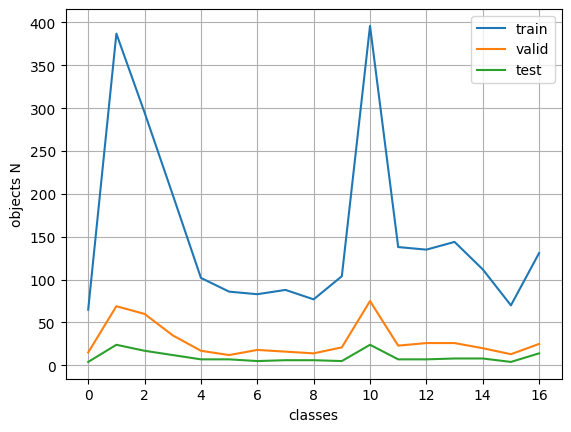

In [ ]:
import matplotlib.pyplot as plt
plt.plot(range(17),hist_train,range(17),hist_valid,range(17),hist_test);
plt.legend(['train', 'valid','test'])
plt.grid()
plt.xlabel('classes')
plt.ylabel('objects N');
plt.savefig('artifacts/eda_2.jpg', dpi=300, bbox_inches='tight')

Дисбаланс по выборкам исправлен, теперь все классы есть во всех выборках.

Проверим отображение файла с разметкой

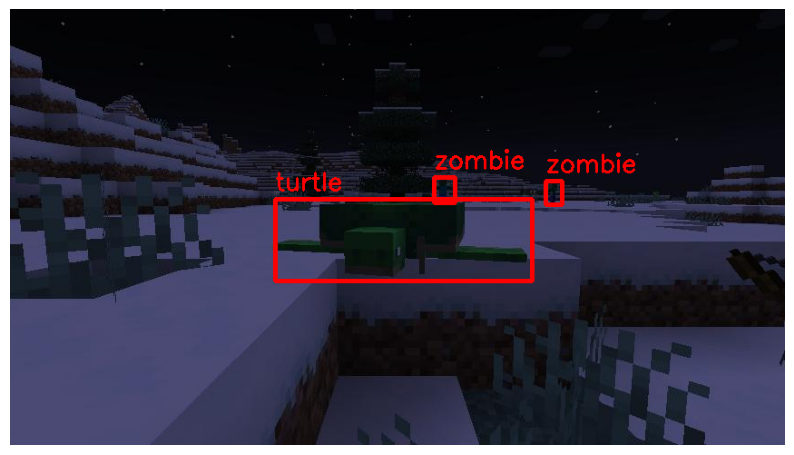

('datasets/minecraft/images/test/2023-03-27_23_05_37_png.rf.5426a92132a3f212df480d289780fa7d.jpg',
 [(14, 292, 209, 575, 299, 854, 480),
  (16, 467, 185, 490, 213, 854, 480),
  (16, 590, 189, 608, 215, 854, 480)])

In [ ]:
import cv2
random_boxes,random_file=all_boxes[2][0]
xml_file=random_file.replace('.jpg', '.xml')
show_image_with_boxes(random_file, random_boxes, savefig=True,file_name='artifacts/eda_3.jpg');

random_file,random_boxes

Маленькие bbox явно меньше чем надо для того, чтобы участвовать в обучении.

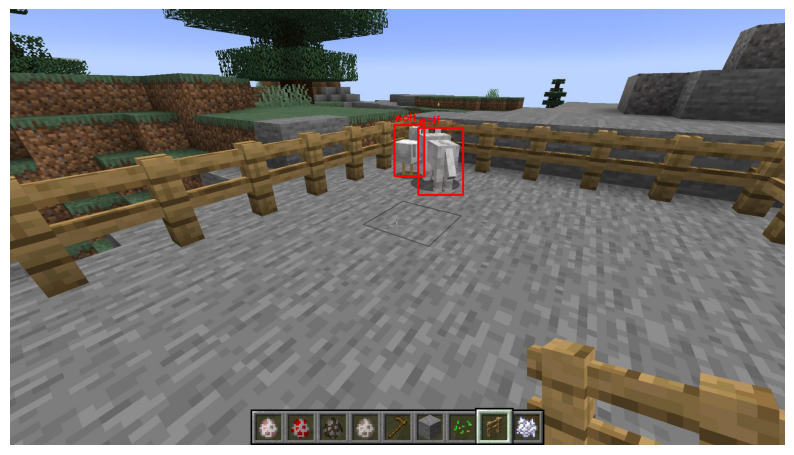

('datasets/minecraft/images/train/Minecraft-1-19-2-2022-11-29-3_44_01_png.rf.ab9bc44577337769e2b9da0bc4e3d6c8.jpg',
 [(15, 1011, 294, 1122, 460, 1920, 1080),
  (15, 952, 287, 1026, 414, 1920, 1080)])

In [ ]:
notrandom_file='datasets/minecraft/images/train/Minecraft-1-19-2-2022-11-29-3_44_01_png.rf.ab9bc44577337769e2b9da0bc4e3d6c8.jpg'
xml_file=notrandom_file.replace('.jpg', '.xml')
notrandom_boxes=parse_annotation(xml_file,cls_dict)
show_image_with_boxes(notrandom_file, notrandom_boxes, savefig=True,file_name='artifacts/eda_4.jpg')
(notrandom_file, notrandom_boxes)

Здесь ошибка разметки. Видно куриные ноги дальнего волка.

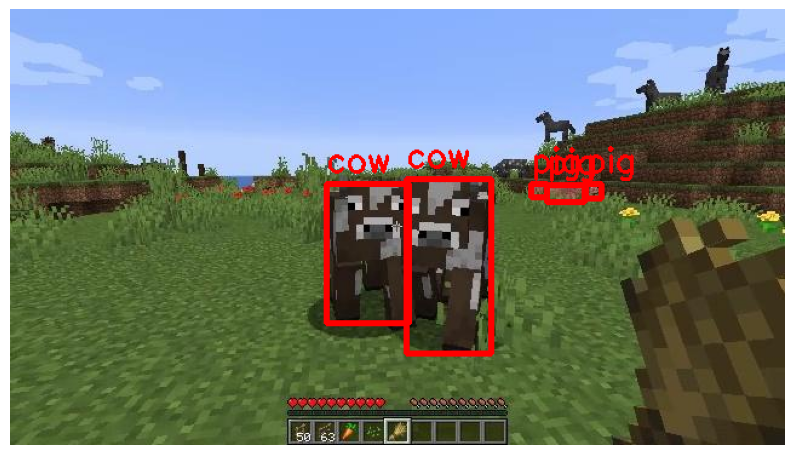

('datasets/minecraft/images/train/grass_desert_-_cow_3_1213_jpg.rf.d65a530b6d3f30f6709afd51032ae0c6.jpg',
 [(2, 261, 144, 329, 259, 640, 360),
  (2, 327, 140, 397, 284, 640, 360),
  (10, 475, 144, 488, 156, 640, 360),
  (10, 443, 145, 474, 159, 640, 360),
  (10, 430, 144, 443, 155, 640, 360)])

In [ ]:
notrandom_file='datasets/minecraft/images/train/grass_desert_-_cow_3_1213_jpg.rf.d65a530b6d3f30f6709afd51032ae0c6.jpg'
xml_file=notrandom_file.replace('.jpg', '.xml')
notrandom_boxes=parse_annotation(xml_file,cls_dict)
show_image_with_boxes(notrandom_file, notrandom_boxes, savefig=True,file_name='artifacts/eda_5.jpg')
(notrandom_file, notrandom_boxes)

Размечены розовые пятна свинок, но не размечены хорошо видные лошадки, так как нет такого класса.

# Конвертация разметки.

Конвертация разметки в coco format на основе обучающего примера библиотеки mmdet.

In [ ]:
# Словарь классов
cls_names=['bee', 'chicken', 'cow', 'creeper', 'enderman', 'fox', 'frog', 'ghast',
'goat', 'llama', 'pig', 'sheep', 'skeleton', 'spider', 'turtle', 'wolf', 'zombie' ]
keys = cls_names
cls_dict = dict(zip(keys, list(range(len(keys)))))
cls_dict

{'bee': 0,
 'chicken': 1,
 'cow': 2,
 'creeper': 3,
 'enderman': 4,
 'fox': 5,
 'frog': 6,
 'ghast': 7,
 'goat': 8,
 'llama': 9,
 'pig': 10,
 'sheep': 11,
 'skeleton': 12,
 'spider': 13,
 'turtle': 14,
 'wolf': 15,
 'zombie': 16}

In [ ]:
txt_path='datasets/minecraft/annotations/classes.txt'
with open(txt_path, 'w') as f:
     for name in cls_names:
         f.write(f"{name} ")

In [ ]:
 # Инициализируем COCO JSON
coco = {
        "images": [],
        "annotations": [],
        "categories":  [
          {"id": cat_id, "name": cat_name, "supercategory": "none"}
          for cat_name, cat_id in zip(keys, list(range(len(keys))))
          ]
        }
coco

{'images': [],
 'annotations': [],
 'categories': [{'id': 0, 'name': 'bee', 'supercategory': 'none'},
  {'id': 1, 'name': 'chicken', 'supercategory': 'none'},
  {'id': 2, 'name': 'cow', 'supercategory': 'none'},
  {'id': 3, 'name': 'creeper', 'supercategory': 'none'},
  {'id': 4, 'name': 'enderman', 'supercategory': 'none'},
  {'id': 5, 'name': 'fox', 'supercategory': 'none'},
  {'id': 6, 'name': 'frog', 'supercategory': 'none'},
  {'id': 7, 'name': 'ghast', 'supercategory': 'none'},
  {'id': 8, 'name': 'goat', 'supercategory': 'none'},
  {'id': 9, 'name': 'llama', 'supercategory': 'none'},
  {'id': 10, 'name': 'pig', 'supercategory': 'none'},
  {'id': 11, 'name': 'sheep', 'supercategory': 'none'},
  {'id': 12, 'name': 'skeleton', 'supercategory': 'none'},
  {'id': 13, 'name': 'spider', 'supercategory': 'none'},
  {'id': 14, 'name': 'turtle', 'supercategory': 'none'},
  {'id': 15, 'name': 'wolf', 'supercategory': 'none'},
  {'id': 16, 'name': 'zombie', 'supercategory': 'none'}]}

Конвертация XML → COCO JSON

In [ ]:
import json
import os
import xml.etree.ElementTree as ET

# Функция для чтения координат  и класса из .xml файла
def parse_annotation(xml_file,cls_dict):
    tree = ET.parse(xml_file)
    root = tree.getroot()
    boxes = []
    imag_prop= root.find('size')
    width = int(imag_prop.find('width').text)
    height = int(imag_prop.find('height').text)

    for obj in root.findall('object'):
        class_name = obj.find('name').text
        bbox = obj.find('bndbox')
        xmin = int(bbox.find('xmin').text)
        ymin = int(bbox.find('ymin').text)
        xmax = int(bbox.find('xmax').text)
        ymax = int(bbox.find('ymax').text)
        boxes.append((cls_dict[class_name],xmin, ymin, xmax, ymax,width,height))

    return boxes


In [ ]:
# Проверка соответствия изображений и аннотаций, запись разметки в формате FCOS, YOLO
all_boxes=[]
for image_folder,label_folder,json_path in zip(image_folders,label_folders,json_paths):
    annotation_folder=image_folder # xml-разметка лежит изначально вместе с image
    # Получение списка всех изображений и соответствующих xml файлов
    images = [f for f in os.listdir(image_folder) if f.endswith(('.jpg', '.png'))]
    annotations = [f.replace('.jpg', '.xml') for f in images]

    folder_boxes=[]
    coco["images"]= []
    coco["annotations"]= []
    image_id = 1
    ann_id = 1

    # чтение координат и класса из .xml файла
    for image_file in images:
        annotation=image_file.replace('.jpg', '.xml')
        annotation=annotation.replace('.png', '.xml')
        image_path = os.path.join(image_folder, image_file)
        annotation_path = os.path.join(annotation_folder, annotation)

        if os.path.exists(annotation_path):
            file_boxes = parse_annotation(annotation_path,cls_dict)
            folder_boxes.append([file_boxes,image_path])

            file_name=annotation.replace('.xml', '.txt')
            file_path = os.path.join(label_folder, file_name)
            try:
                with open(file_path, "w") as file:
                    for (cls, xmin, ymin, xmax, ymax,width,height) in file_boxes:
                        xc=(xmax+xmin)/2/width
                        yc=(ymax+ymin)/2/height
                        dx=(xmax - xmin)/width
                        dy=(ymax - ymin)/height
                        file.write(f'{cls} {xc} {yc} {dx} {dy}\n')

            except:
                print(f"Ошибка при работе с файлом {file_name}")

            for (cls, xmin, ymin, xmax, ymax,width,height) in file_boxes:
                        w = xmax - xmin
                        h = ymax - ymin
                        coco["annotations"].append({
                                             "id": ann_id,
                                             "image_id": image_id,
                                             "category_id": cls,
                                             "bbox": [xmin, ymin, w, h],
                                             "area": float(w * h),
                                             "iscrowd": 0,
                                             "segmentation": []
                        })
                        ann_id += 1

            # Добавляем изображение
            coco["images"].append({
                      "id": image_id,
                      "file_name": image_file,
                      "width": width,
                      "height": height
                })
            image_id += 1

        else:
            print(f"Разметка для изображения {image_path} не найдена. Изображение удалено.")
            os.remove(image_path)

    print(f"Разметка для папки {image_folder} найдено {len(folder_boxes)} файла.")
    all_boxes.append(folder_boxes)
    with open(json_path, 'w') as f:
        json.dump(coco, f, indent=2)


Разметка для папки datasets/minecraft/images/train найдено 2305 файла.
Разметка для папки datasets/minecraft/images/val найдено 432 файла.
Разметка для папки datasets/minecraft/images/test найдено 145 файла.


Проверка формата разметки

In [ ]:
from pycocotools.coco import COCO
coco=COCO("datasets/minecraft/annotations/val.json")

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


In [ ]:
img = coco.loadImgs(1)[0]
img

{'id': 1,
 'file_name': 'Screenshot-233-_png.rf.cbb16d526a6c387cabfe9bbac7938fbd.jpg',
 'width': 1920,
 'height': 1080}

In [ ]:
annIds = coco.getAnnIds(imgIds=img['id'], iscrowd=None)
anns = coco.loadAnns(annIds)
anns[0]

{'id': 1,
 'image_id': 1,
 'category_id': 12,
 'bbox': [959, 263, 134, 296],
 'area': 39664.0,
 'iscrowd': 0,
 'segmentation': []}

Сохраним в архив датасет с аннотациями, чтобы использовать потом для расчета на ВМ

In [ ]:
shutil.make_archive('datasets/minecraft_with_labels', 'zip', 'datasets/minecraft')

'/content/onedl-mmdetection/datasets/minecraft_with_labels.zip'

# Конфигурация FCOS для обучения

In [ ]:
fcos_config = f'''
_base_ = [
    'mmdet::_base_/datasets/coco_detection.py',
    'mmdet::_base_/schedules/schedule_1x.py',
    'mmdet::_base_/default_runtime.py'
]

# Модель
model = dict(
    type='FCOS',
    data_preprocessor=dict(
        type='DetDataPreprocessor',
        mean=[103.530, 116.280, 123.675],
        std=[1.0, 1.0, 1.0],
        bgr_to_rgb=False,
        pad_size_divisor=32),
    backbone=dict(
        type='ResNet',
        depth=50,
        num_stages=4,
        out_indices=(0, 1, 2, 3),
        frozen_stages=1,
        norm_cfg=dict(type='BN', requires_grad=False),
        norm_eval=True,
        style='caffe',
        init_cfg=dict(
            type='Pretrained',
            checkpoint='open-mmlab://detectron2/resnet50_caffe')),
    neck=dict(
        type='FPN',
        in_channels=[256, 512, 1024, 2048],
        out_channels=256,
        start_level=1,
        add_extra_convs='on_output',
        num_outs=5,
        relu_before_extra_convs=True),
    bbox_head=dict(
        type='FCOSHead',
        num_classes=17,
        in_channels=256,
        stacked_convs=4,
        feat_channels=256,
        strides=[8, 16, 32, 64, 128],
        norm_on_bbox=True,
        centerness_on_reg=True,
        dcn_on_last_conv=False,
        conv_bias=True,
        loss_cls=dict(
            type='FocalLoss',
            use_sigmoid=True,
            gamma=2.0,
            alpha=0.25,
            loss_weight=1.0),
        loss_bbox=dict(type='GIoULoss', loss_weight=1.0),
        loss_centerness=dict(
            type='CrossEntropyLoss', use_sigmoid=True, loss_weight=1.0)),
    test_cfg=dict(
        nms_pre=1000,
        min_bbox_size=0,
        score_thr=0.05,
        nms=dict(type='nms', iou_threshold=0.5),
        max_per_img=100))

# Данные
CLASSES = ('bee', 'chicken', 'cow', 'creeper', 'enderman', 'fox', 'frog', 'ghast',
'goat', 'llama', 'pig', 'sheep', 'skeleton', 'spider', 'turtle', 'wolf', 'zombie',)

data_root = 'datasets/minecraft/'
metainfo = dict(classes=CLASSES)

train_dataloader = dict(
    batch_size=2,
    num_workers=2,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        ann_file='annotations/train.json',
        data_prefix=dict(img='images/train/'),
        pipeline=[
            dict(type='LoadImageFromFile'),
            dict(type='LoadAnnotations', with_bbox=True),
            dict(type='Resize', scale=(512, 512), keep_ratio=False),
            dict(type='RandomFlip', prob=0.5),
            dict(type='PackDetInputs')
        ]))

val_dataloader = dict(
    batch_size=2,
    num_workers=2,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        ann_file='annotations/val.json',
        data_prefix=dict(img='images/val/'),
        pipeline=[
            dict(type='LoadImageFromFile'),
            dict(type='Resize', scale=(512, 512), keep_ratio=True),
            dict(type='LoadAnnotations', with_bbox=True),
            dict(type='PackDetInputs')
        ]))

test_dataloader = val_dataloader

# Оценка
val_evaluator = dict(
    type='CocoMetric',
    ann_file=data_root + 'annotations/val.json',
    metric='bbox',
    format_only=False)
test_evaluator = val_evaluator

# Обучение
train_cfg = dict(type='EpochBasedTrainLoop', max_epochs=12, val_interval=1)
val_cfg = dict(type='ValLoop')
test_cfg = dict(type='TestLoop')

# Оптимизатор
optim_wrapper = dict(
    type='OptimWrapper',
    optimizer=dict(type='SGD', lr=0.001, momentum=0.9, weight_decay=0.0001))

# Планировщик
param_scheduler = [
    dict(type='LinearLR', start_factor=0.001, by_epoch=False, begin=0, end=500),
    dict(type='MultiStepLR', by_epoch=True, milestones=[8, 11], gamma=0.1)
]

# Чекпоинты
default_hooks = dict(
    checkpoint=dict(type='CheckpointHook', interval=1, max_keep_ckpts=3),
    logger=dict(type='LoggerHook', interval=50))

# FP16
fp16 = dict(loss_scale='dynamic')
'''

with open('configs/fcos/fcos_minecraft.py', 'w') as f:
    f.write(fcos_config)

Загружаем конфиг и проверим

In [ ]:
from mmengine.config import Config

# Загружаем конфиг и проверим
config_file = 'configs/fcos/fcos_minecraft.py'
cfg = Config.fromfile(config_file)
cfg.default_hooks

{'timer': {'type': 'IterTimerHook', '_scope_': 'mmdet'},
 'logger': {'type': 'LoggerHook', 'interval': 50, '_scope_': 'mmdet'},
 'param_scheduler': {'type': 'ParamSchedulerHook', '_scope_': 'mmdet'},
 'checkpoint': {'type': 'CheckpointHook',
  'interval': 1,
  '_scope_': 'mmdet',
  'max_keep_ckpts': 3},
 'sampler_seed': {'type': 'DistSamplerSeedHook', '_scope_': 'mmdet'},
 'visualization': {'type': 'DetVisualizationHook', '_scope_': 'mmdet'}}

Перед обучением протестируйте инференс на pretrained-модели FCOS в ноутбуке.
Для этого:
1. Скачайте чекпоинт <…>.pth для вашей модели из официального репозитория и положите в папку checkpoints/.
2. В ячейке Jupyter Notebook'а импортируйте предобученный чекпоинт checkpoints/fcos_<…>.pth базовой модели и вашу конфигурацию fcos_minecraft.py.
3. Визуализируйте результат детекции на одном изображении.
4. Сохраните результат в artifacts/inference/test_pretrained.jpg.

Loads checkpoint by local backend from path: ./checkpoints/fcos_r50_caffe_fpn_gn-head_1x_coco-821213aa.pth


Output()

The model and loaded state dict do not match exactly

size mismatch for bbox_head.conv_cls.weight: copying a param with shape torch.Size([80, 256, 3, 3]) from checkpoint, the shape in current model is torch.Size([17, 256, 3, 3]).
size mismatch for bbox_head.conv_cls.bias: copying a param with shape torch.Size([80]) from checkpoint, the shape in current model is torch.Size([17]).
missing keys in source state_dict: bbox_head.cls_convs.0.conv.bias, bbox_head.cls_convs.1.conv.bias, bbox_head.cls_convs.2.conv.bias, bbox_head.cls_convs.3.conv.bias, bbox_head.reg_convs.0.conv.bias, bbox_head.reg_convs.1.conv.bias, bbox_head.reg_convs.2.conv.bias, bbox_head.reg_convs.3.conv.bias



/usr/local/lib/python3.12/dist-packages/mmengine/visualization/visualizer.py:196: UserWarning: Failed to add <class 'mmengine.visualization.vis_backend.LocalVisBackend'>, please provide the `save_dir` argument.
  warnings.warn(f'Failed to add {vis_backend.__class__}, '


/usr/local/lib/python3.12/dist-packages/mmengine/visualization/visualizer.py:760: UserWarning: Warning: The bbox is
out of bounds, the drawn bbox may not be in the image
  warnings.warn(

/usr/local/lib/python3.12/dist-packages/mmengine/visualization/visualizer.py:831: UserWarning: Warning: The polygon
is out of bounds, the drawn polygon may not be in the image
  warnings.warn(

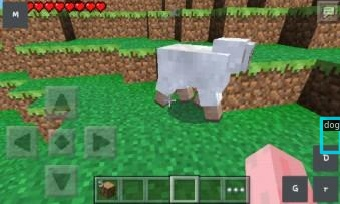

In [ ]:
from PIL import Image
from mmdet.apis import DetInferencer

# Choose to use a config
config_path = './configs/fcos/fcos_minecraft.py' # внезапно файл, который сочинили

# Setup a checkpoint file to load
checkpoint = './checkpoints/fcos_r50_caffe_fpn_gn-head_1x_coco-821213aa.pth'

# Initialize the DetInferencer
inferencer = DetInferencer(model=config_path, weights=checkpoint)

# Perform inference
img_path = './datasets/minecraft/images/train/'
#img_file='-5-_jpg.rf.bc815ec81b67584c880eb373c6de746a.jpg'
img_file = '-46-_jpg.rf.174ff6d9f9f02a9a84d10ce98fc36abc.jpg'

img=img_path + img_file
# Сохраните результат в artifacts/inference/fcos/test_pretrained
out_dir='artifacts/fcos/inference_test_pretrained'

inferencer(img, out_dir=out_dir)
Image.open(out_dir + '/vis/' + img_file)


В выводе показана ошибка связанная с числом классов 17 вместо 80. На референсе могут быть видны классы исходной модели.

На следующем шаге при обучении(на этапе оценки обучения на валидационной части) вылезает ошибка

> File "/content/onedl-mmdetection/mmdet/evaluation/metrics/coco_metric.py", line 462, in compute_metrics
    coco_dt = self._coco_api.loadRes(predictions)
              ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/pycocotools/coco.py", line 314, in loadRes
    res.dataset['info'] = copy.deepcopy(self.dataset['info'])
                                        ~~~~~~~~~~~~^^^^^^^^
KeyError: 'info'

или в файле
> /content/onedl-mmdetection/mmdet/evaluation/metrics/faster_coco_metric.py

и я ее исправила грубо в том файле, в котором она вылезла.
Просто вставила строчку типа такой строка 167 в файле
/content/onedl-mmdetection/mmdet/evaluation/metrics/faster_coco_metric.py
> self._coco_api.dataset['info'] = 'info';

In [ ]:
import shutil
shutil.copyfile('/content/drive/MyDrive/faster_coco_metric.py','/content/onedl-mmdetection/mmdet/evaluation/metrics/faster_coco_metric.py')

'/content/onedl-mmdetection/mmdet/evaluation/metrics/faster_coco_metric.py'

Запуск обучения из командной строки (так было в обучающем примере)

In [ ]:
!python tools/train.py configs/fcos/fcos_minecraft.py

2026-01-14 15:41:39.554825: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1768405299.595395    6380 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1768405299.606943    6380 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1768405299.641502    6380 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1768405299.641567    6380 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1768405299.641572    6380 computation_placer.cc:177] computation placer alr

Запуск через функцию Runner (установлен пакет onedl-mmengine для питона 3.12, торч версии 2.9+cpu). Еще можно, например, изменить с дефолтной директорию для сохранения checkpoint

In [ ]:
from mmengine.runner import Runner
from mmengine.config import Config

# Загружаем конфиг
config_file = 'configs/fcos/fcos_minecraft.py'
cfg = Config.fromfile(config_file)

# Обновляем пути
cfg.work_dir = 'artifacts/fcos'
cfg.default_hooks.checkpoint.out_dir = 'checkpoints/fcos'

# Запускаем обучение
print("🚀 Запуск обучения FCOS...")
runner = Runner.from_cfg(cfg)
runner.train()

print("✅ Обучение FCOS завершено")

🚀 Запуск обучения FCOS...
01/14 15:58:06 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.12.12 (main, Oct 10 2025, 08:52:57) [GCC 11.4.0]
    CUDA available: False
    MUSA available: False
    numpy_random_seed: 557637844
    GCC: x86_64-linux-gnu-gcc (Ubuntu 11.4.0-1ubuntu1~22.04.2) 11.4.0
    PyTorch: 2.9.0+cpu
    PyTorch compiling details: PyTorch built with:
  - GCC 13.3
  - C++ Version: 201703
  - Intel(R) oneAPI Math Kernel Library Version 2024.2-Product Build 20240605 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v3.7.1 (Git Hash 8d263e693366ef8db40acc569cc7d8edf644556d)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided by MKL)
  - NNPACK is enabled
  - CPU capability usage: AVX2
  - Build settings: BLAS_INFO=mkl, BUILD_TYPE=Release, COMMIT_SHA=0fabc3ba44823f257e70ce397d989c8de5e362c1, CXX_COMPILER=/opt/rh/gcc-toolset-13/root/usr/bin/c++, CXX

/usr/local/lib/python3.12/dist-packages/mmengine/utils/manager.py:113: UserWarning: <class 'mmdet.visualization.local_visualizer.DetLocalVisualizer'> instance named of visualizer has been created, the method `get_instance` should not accept any other arguments
  warnings.warn(


01/14 15:58:06 - mmengine - INFO - Distributed training is not used, all SyncBatchNorm (SyncBN) layers in the model will be automatically reverted to BatchNormXd layers if they are used.
01/14 15:58:06 - mmengine - INFO - Hooks will be executed in the following order:
before_run:
(VERY_HIGH   ) RuntimeInfoHook                    
(BELOW_NORMAL) LoggerHook                         
 -------------------- 
before_train:
(VERY_HIGH   ) RuntimeInfoHook                    
(NORMAL      ) IterTimerHook                      
(VERY_LOW    ) CheckpointHook                     
 -------------------- 
before_train_epoch:
(VERY_HIGH   ) RuntimeInfoHook                    
(NORMAL      ) IterTimerHook                      
(NORMAL      ) DistSamplerSeedHook                
 -------------------- 
before_train_iter:
(VERY_HIGH   ) RuntimeInfoHook                    
(NORMAL      ) IterTimerHook                      
 -------------------- 
after_train_iter:
(VERY_HIGH   ) RuntimeInfoHook                

KeyboardInterrupt: 

Считать еще раз долго, используем для референса сохраненный файл после 12 эпох. Разницу во времени выполнения можно оценить по следующему фрагменту

```
# фрагмент запуска на ВМ

01/11 14:10:02 - mmengine - INFO - Epoch(train)  [1][  50/1153]  lr: 9.9098e-05  eta: 0:21:58  time: 0.0956  data_time: 0.0095  memory: 1278  loss: 2.7271  loss_cls: 1.0058  loss_bbox: 1.0030  loss_centerness: 0.7183
01/11 14:10:06 - mmengine - INFO - Epoch(train)  [1][ 100/1153]  lr: 1.9920e-04  eta: 0:21:26  time: 0.0918  data_time: 0.0065  memory: 1278  loss: 2.5127  loss_cls: 0.8508  loss_bbox: 1.0000  loss_centerness: 0.6619
01/11 14:10:11 - mmengine - INFO - Epoch(train)  [1][ 150/1153]  lr: 2.9930e-04  eta: 0:21:10  time: 0.0910  data_time: 0.0054  memory: 1278  loss: 2.4380  loss_cls: 0.7854  loss_bbox: 1.0000  loss_centerness: 0.6525
01/11 14:10:15 - mmengine - INFO - Epoch(train)  [1][ 200/1153]  lr: 3.9940e-04  eta: 0:20:58  time: 0.0907  data_time: 0.0051  memory: 1278  loss: 2.3715  loss_cls: 0.7153  loss_bbox: 1.0000  loss_centerness: 0.6562
01/11 14:10:20 - mmengine - INFO - Epoch(train)  [1][ 250/1153]  lr: 4.9950e-04  eta: 0:20:46  time: 0.0896  data_time: 0.0055  memory: 1278  loss: 2.3527  loss_cls: 0.7149  loss_bbox: 1.0000  loss_centerness: 0.6378
01/11 14:10:24 - mmengine - INFO - Epoch(train)  [1][ 300/1153]  lr: 5.9960e-04  eta: 0:20:39  time: 0.0908  data_time: 0.0051  memory: 1278  loss: 2.3862  loss_cls: 0.7414  loss_bbox: 1.0000  loss_centerness: 0.6448
01/11 14:10:29 - mmengine - INFO - Epoch(train)  [1][ 350/1153]  lr: 6.9970e-04  eta: 0:20:31  time: 0.0900  data_time: 0.0050  memory: 1278  loss: 2.4028  loss_cls: 0.7594  loss_bbox: 1.0000  loss_centerness: 0.6434
01/11 14:10:33 - mmengine - INFO - Epoch(train)  [1][ 400/1153]  lr: 7.9980e-04  eta: 0:20:26  time: 0.0911  data_time: 0.0051  memory: 1278  loss: 2.3120  loss_cls: 0.6796  loss_bbox: 1.0000  loss_centerness: 0.6324
01/11 14:10:38 - mmengine - INFO - Epoch(train)  [1][ 450/1153]  lr: 8.9990e-04  eta: 0:20:22  time: 0.0916  data_time: 0.0056  memory: 1278  loss: 2.1678  loss_cls: 0.5447  loss_bbox: 0.9991  loss_centerness: 0.6240
```

Ячейка с тем же кодом запущенная в аутентичном mmdetection на BM

In [ ]:
from mmengine.runner import Runner
from mmengine.config import Config

# Загружаем конфиг
config_file = 'configs/fcos/fcos_minecraft.py'
cfg = Config.fromfile(config_file)

# Обновляем пути
cfg.work_dir = 'artifacts/fcos'
cfg.default_hooks.checkpoint.out_dir = cfg.work_dir

# Запускаем обучение
print("🚀 Запуск обучения FCOS...")
runner = Runner.from_cfg(cfg)
runner.train()

print("✅ Обучение FCOS завершено")

🚀 Запуск обучения FCOS...
01/11 14:09:53 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.10.12 (main, Jun 11 2023, 05:26:28) [GCC 11.4.0]
    CUDA available: True
    MUSA available: False
    numpy_random_seed: 1560978443
    GPU 0: Tesla V100-PCIE-32GB
    CUDA_HOME: /usr/local/cuda
    NVCC: Cuda compilation tools, release 11.8, V11.8.89
    GCC: x86_64-linux-gnu-gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0
    PyTorch: 2.1.2+cu118
    PyTorch compiling details: PyTorch built with:
  - GCC 9.3
  - C++ Version: 201703
  - Intel(R) oneAPI Math Kernel Library Version 2022.2-Product Build 20220804 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v3.1.1 (Git Hash 64f6bcbcbab628e96f33a62c3e975f8535a7bde4)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided by MKL)
  - NNPACK is enabled
  - CPU capability usage: AVX2
  - CUDA Runtime 11.8
  - NVCC architecture fl

In [ ]:
CLASSES = ['bee', 'chicken', 'cow', 'creeper', 'enderman', 'fox', 'frog', 'ghast',
'goat', 'llama', 'pig', 'sheep', 'skeleton', 'spider', 'turtle', 'wolf', 'zombie' ]

Внезапно оказалось, что я использовала на ВМ вариант с keep_ratio=False и еще какой-то разницей, поэтому веса 12 эпохи не подошли к конфигу, верну назад, иначе референс не работает

In [8]:
fcos_config = f'''
_base_ = [
    'mmdet::_base_/datasets/coco_detection.py',
    'mmdet::_base_/schedules/schedule_1x.py',
    'mmdet::_base_/default_runtime.py'
]

# Модель
model = dict(
    type='FCOS',
    data_preprocessor=dict(
        type='DetDataPreprocessor',
        mean=[103.530, 116.280, 123.675],
        std=[1.0, 1.0, 1.0],
        bgr_to_rgb=False,
        pad_size_divisor=32),
    backbone=dict(
        type='ResNet',
        depth=50,
        num_stages=4,
        out_indices=(0, 1, 2, 3),
        frozen_stages=1,
        norm_cfg=dict(type='BN', requires_grad=False),
        norm_eval=True,
        style='caffe',
        init_cfg=dict(
            type='Pretrained',
            checkpoint='open-mmlab://detectron2/resnet50_caffe')),
    neck=dict(
        type='FPN',
        in_channels=[256, 512, 1024, 2048],
        out_channels=256,
        start_level=1,
        add_extra_convs='on_output',
        num_outs=5,
        relu_before_extra_convs=True),
    bbox_head=dict(
        type='FCOSHead',
        num_classes=17,
        in_channels=256,
        stacked_convs=4,
        feat_channels=256,
        strides=[8, 16, 32, 64, 128],
        norm_on_bbox=True,
        centerness_on_reg=True,
        dcn_on_last_conv=False,
        conv_bias=True,
        loss_cls=dict(
            type='FocalLoss',
            use_sigmoid=True,
            gamma=2.0,
            alpha=0.25,
            loss_weight=1.0),
        loss_bbox=dict(type='GIoULoss', loss_weight=1.0),
        loss_centerness=dict(
            type='CrossEntropyLoss', use_sigmoid=True, loss_weight=1.0)),
    test_cfg=dict(
        nms_pre=1000,
        min_bbox_size=0,
        score_thr=0.05,
        nms=dict(type='nms', iou_threshold=0.5),
        max_per_img=100))

# Данные
CLASSES = ('bee', 'chicken', 'cow', 'creeper', 'enderman', 'fox', 'frog', 'ghast',
'goat', 'llama', 'pig', 'sheep', 'skeleton', 'spider', 'turtle', 'wolf', 'zombie',)

data_root = 'datasets/minecraft/'
metainfo = dict(classes=CLASSES)

train_dataloader = dict(
    batch_size=2,
    num_workers=2,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        ann_file='annotations/train.json',
        data_prefix=dict(img='images/train/'),
        pipeline=[
            dict(type='LoadImageFromFile'),
            dict(type='LoadAnnotations', with_bbox=True),
            dict(type='Resize', scale=(512, 512), keep_ratio=False),
            dict(type='RandomFlip', prob=0.5),
            dict(type='PackDetInputs')
        ]))

val_dataloader = dict(
    batch_size=2,
    num_workers=2,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        ann_file='annotations/val.json',
        data_prefix=dict(img='images/val/'),
        pipeline=[
            dict(type='LoadImageFromFile'),
            dict(type='Resize', scale=(512, 512), keep_ratio=False),
            dict(type='LoadAnnotations', with_bbox=True),
            dict(type='PackDetInputs')
        ]))

test_dataloader = val_dataloader

# Оценка
val_evaluator = dict(
    type='CocoMetric',
    ann_file=data_root + 'annotations/val.json',
    metric='bbox',
    format_only=False)
test_evaluator = val_evaluator

# Обучение
train_cfg = dict(type='EpochBasedTrainLoop', max_epochs=12, val_interval=1)
val_cfg = dict(type='ValLoop')
test_cfg = dict(type='TestLoop')

# Оптимизатор
optim_wrapper = dict(
    type='OptimWrapper',
    optimizer=dict(type='SGD', lr=0.001, momentum=0.9, weight_decay=0.0001))

# Планировщик
param_scheduler = [
    dict(type='LinearLR', start_factor=0.001, by_epoch=False, begin=0, end=500),
    dict(type='MultiStepLR', by_epoch=True, milestones=[8, 11], gamma=0.1)
]

# Чекпоинты
default_hooks = dict(
    checkpoint=dict(type='CheckpointHook', interval=1, max_keep_ckpts=3),
    logger=dict(type='LoggerHook', interval=50))

# FP16
fp16 = dict(loss_scale='dynamic')
'''

with open('configs/fcos/fcos_minecraft.py', 'w') as f:
    f.write(fcos_config)



In [9]:
mkdir artifacts/fcos/fcos

In [10]:
shutil.copyfile('/content/drive/MyDrive/fcos_minecraft_epoch_12.pth','./checkpoints/fcos_epoch_12.pth')

'./checkpoints/fcos_epoch_12.pth'

In [16]:
from mmdet.apis import DetInferencer
from mmdet.apis import init_detector, inference_detector

# Choose to use a config
config_path = './configs/fcos/fcos_minecraft.py' # внезапно файл, который сочинили

# Setup a checkpoint file to load
checkpoint = './checkpoints/fcos_epoch_12.pth'

# Initialize the DetInferencer
inferencer = DetInferencer(model=config_path, weights=checkpoint)


Loads checkpoint by local backend from path: ./checkpoints/fcos_epoch_12.pth
Could not safely load weights: Weights only load failed. This file can still be loaded, to do so you have two options, do those steps only if you trust the source of the checkpoint. 
	(1) In PyTorch 2.6, we changed the default value of the `weights_only` argument in `torch.load` from `False` to `True`. Re-running `torch.load` with `weights_only` set to `False` will likely succeed, but it can result in arbitrary code execution. Do it only if you got the file from a trusted source.
	(2) Alternatively, to load with `weights_only=True` please check the recommended steps in the following error message.
	WeightsUnpickler error: Unsupported global: GLOBAL numpy.core.multiarray._reconstruct was not an allowed global by default. Please use `torch.serialization.add_safe_globals([numpy.core.multiarray._reconstruct])` or the `torch.serialization.safe_globals([numpy.core.multiarray._reconstruct])` context manager to allowl

/content/onedl-mmdetection/mmdet/models/backbones/trident_resnet.py:244: SyntaxWarning: invalid escape sequence '\ '
  \ stage3(b2) /
/content/onedl-mmdetection/mmdet/models/dense_heads/free_anchor_retina_head.py:290: SyntaxWarning: invalid escape sequence '\i'
  :math:`FL((1 - P_{a_{j} \in A_{+}}) * (1 - P_{j}^{bg}))`.


01/17 13:17:02 - mmengine - WARNING - Failed to search registry with scope "mmdet" in the "function" registry tree. As a workaround, the current "function" registry in "mmengine" is used to build instance. This may cause unexpected failure when running the built modules. Please check whether "mmdet" is a correct scope, or whether the registry is initialized.


/usr/local/lib/python3.12/dist-packages/mmengine/visualization/visualizer.py:196: UserWarning: Failed to add <class 'mmengine.visualization.vis_backend.LocalVisBackend'>, please provide the `save_dir` argument.
  warnings.warn(f'Failed to add {vis_backend.__class__}, '


Output()

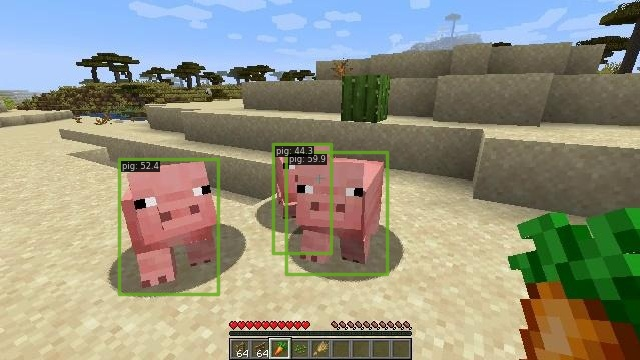

In [ ]:
img_path = './datasets/minecraft/images/train/'
img_file = 'desert_-_pig_1375_jpg.rf.bddcc2b2bd1ccf7330cd274d684fd4e2.jpg'
img=img_path + img_file
out_dir='artifacts/inference/fcos'
inferencer(img, out_dir=out_dir)
Image.open(out_dir + '/vis/' + img_file)

Output()

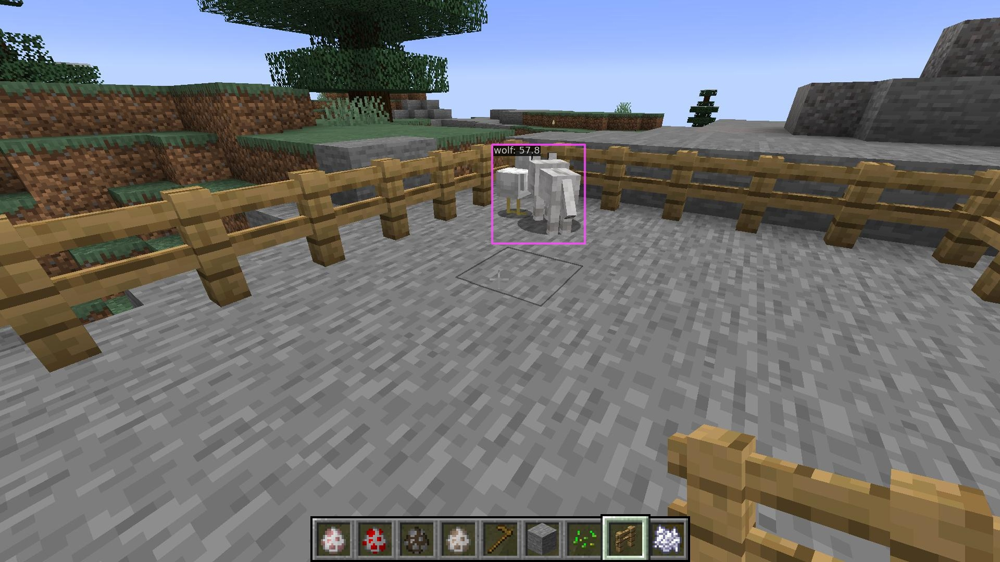

In [ ]:
img_path = './datasets/minecraft/images/train/'
img_file = 'Minecraft-1-19-2-2022-11-29-3_44_01_png.rf.ab9bc44577337769e2b9da0bc4e3d6c8.jpg'
img=img_path + img_file
inferencer(img, out_dir=out_dir)
Image.open(out_dir + '/vis/' + img_file)

Output()

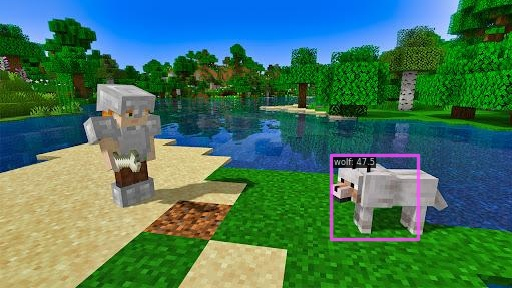

In [ ]:
# Perform inference
img_path = 'datasets/minecraft/images/train/'
img_file='wolf12_jpg.rf.c26d5b06eae27a9ec8f93e9ade0f54dc.jpg'
img=img_path + img_file

inferencer(img, out_dir=out_dir)
Image.open(out_dir + '/vis/' + img_file)

Output()

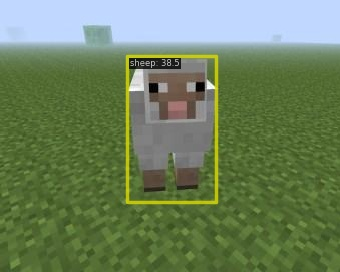

In [ ]:
# Perform inference
img_path = 'datasets/minecraft/images/train/'
img_file='-5-_jpg.rf.bc815ec81b67584c880eb373c6de746a.jpg'
img=img_path + img_file

inferencer(img, out_dir=out_dir)
Image.open(out_dir + '/vis/' + img_file)


Output()

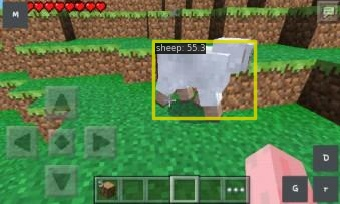

In [ ]:
# Perform inference
img_path = 'datasets/minecraft/images/train/'
img_file='-46-_jpg.rf.174ff6d9f9f02a9a84d10ce98fc36abc.jpg'
img=img_path + img_file

inferencer(img, out_dir=out_dir)
Image.open(out_dir + '/vis/' + img_file)


Output()

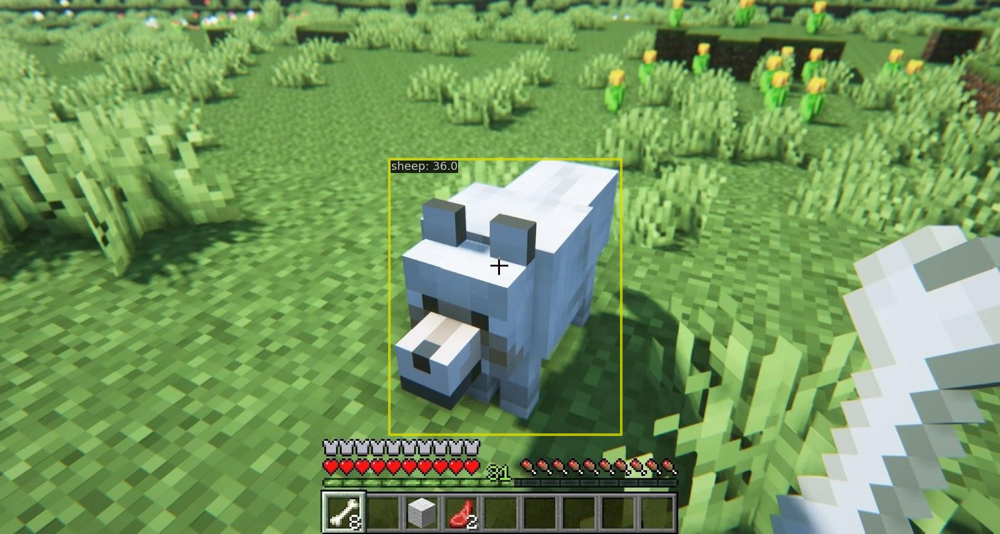

In [ ]:
# Perform inference
img_path = 'datasets/minecraft/images/train/'
img_file='wolf21_jpg.rf.0725f28587c88d80f546cbf3bbdb4c29.jpg'
img=img_path + img_file

inferencer(img, out_dir=out_dir)
Image.open(out_dir + '/vis/' + img_file)

Теперь что-нибудь из директорий валид и тест

Output()

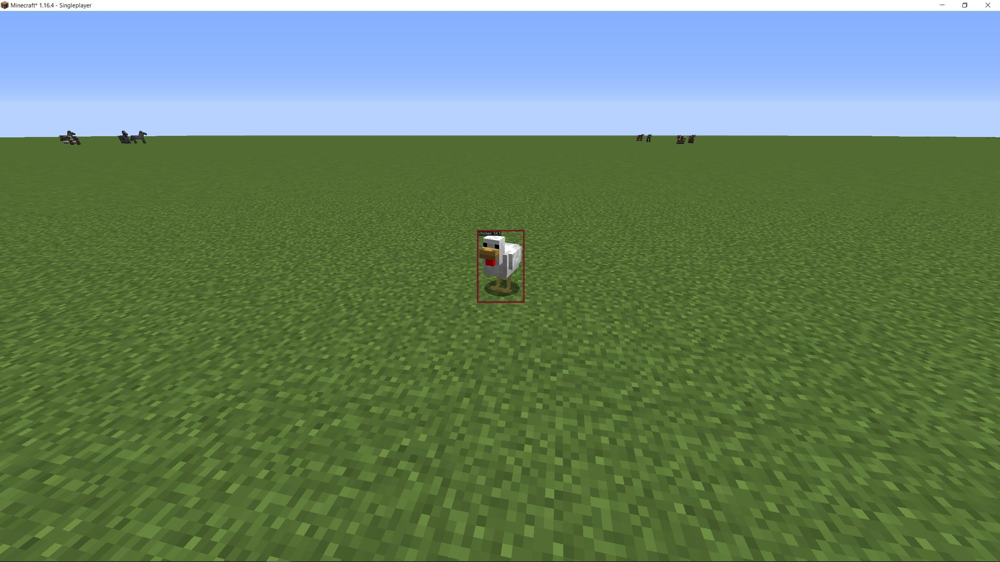

In [ ]:
# Perform inference
img_path = 'datasets/minecraft/images/val/'
img_file='130_png.rf.6cdf3e3b837a5e286c2203dd6e58ece8.jpg'
img=img_path + img_file

inferencer(img, out_dir=out_dir)
Image.open(out_dir + '/vis/' + img_file)

Output()

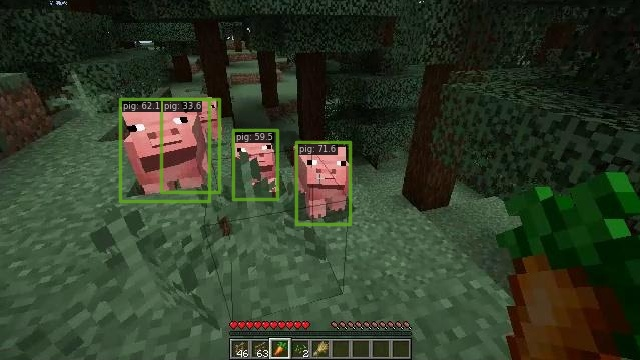

In [ ]:
# Perform inference
img_path = 'datasets/minecraft/images/test/'
img_file='forest_-_pig_2_1762_jpg.rf.ecd7f773b34ac2f4c8a33f8015bfe81c.jpg'
img=img_path + img_file

inferencer(img, out_dir=out_dir)
Image.open(out_dir + '/vis/' + img_file)

Output()

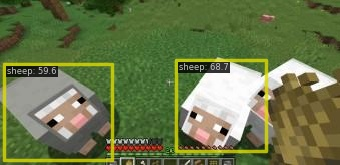

In [45]:
out_dir='artifacts/inference/fcos'
# Perform inference
img_path = 'datasets/minecraft/'
img_file='-51-_jpg.rf.72894c256b73a11345b5cac41f291018.jpg'
img=img_path + img_file

inferencer(img, out_dir=out_dir)
Image.open(out_dir + '/vis/' + img_file)

In [11]:
dataset_dir = 'datasets/minecraft'
os.makedirs(dataset_dir, exist_ok=True)

In [12]:
import os
import requests
import zipfile
import shutil

# Пути
dataset_dir = 'datasets/minecraft'
video_url = "https://code.s3.yandex.net/deep-learning/video.mp4"
# Скачиваем видео
print("📥 Скачивание видео...")
video_file_path = os.path.join(dataset_dir, 'video.mp4')
response = requests.get(video_url, stream=True)
response.raise_for_status()
with open(video_file_path, 'wb') as f:
    for chunk in response.iter_content(chunk_size=8192):
        f.write(chunk)
print("✅ Видео скачано")


📥 Скачивание видео...
✅ Видео скачано


In [73]:
import cv2
from mmdet.apis import init_detector, inference_detector
import argparse
from tqdm import tqdm

# Загружаем модель
model = init_detector(config_path, checkpoint, device='cpu')

input_video_path='datasets/minecraft/video.mp4'
#/content/onedl-mmdetection/artifacts/inference/fcos
output_video_path='artifacts/videos/fcos_video_thr02.mp4'
confidence_threshold=0.2
imgsz=512
current_color = (0, 0, 255)

cap = cv2.VideoCapture(input_video_path)
if not cap.isOpened():
    print(f"Ошибка: не удалось открыть видеофайл {input_video_path}")
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_video_path, fourcc, fps, (frame_width, frame_height))

with tqdm(total=total_frames, desc="Анализ игрового процесса") as pbar:
    while cap.isOpened():
        success, frame = cap.read()
        if not success:
            break

        results = inference_detector(model, frame)
        # Получаем bboxes, scores и labels
        bboxes = results.pred_instances.bboxes
        scores = results.pred_instances.scores
        labels = results.pred_instances.labels
        for box, conf, class_id in zip(bboxes,scores,labels):
          if conf>confidence_threshold:
                    x1, y1, x2, y2 = map(int, box)
                    #conf, class_id = float(box.conf[0]), int(box.cls[0])
                    label = f"{cls_names[class_id]} {conf:.2f}"
                    cv2.rectangle(frame, (x1, y1), (x2, y2), current_color, 2)
                    cv2.putText(frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, current_color, 2)

        out.write(frame)
        pbar.update(1)


cap.release()
out.release()
print(f"\nАнализ завершен. Результат сохранен в файл: {output_video_path}")

Loads checkpoint by local backend from path: ./checkpoints/fcos_epoch_12.pth
Could not safely load weights: Weights only load failed. This file can still be loaded, to do so you have two options, do those steps only if you trust the source of the checkpoint. 
	(1) In PyTorch 2.6, we changed the default value of the `weights_only` argument in `torch.load` from `False` to `True`. Re-running `torch.load` with `weights_only` set to `False` will likely succeed, but it can result in arbitrary code execution. Do it only if you got the file from a trusted source.
	(2) Alternatively, to load with `weights_only=True` please check the recommended steps in the following error message.
	WeightsUnpickler error: Unsupported global: GLOBAL numpy.core.multiarray._reconstruct was not an allowed global by default. Please use `torch.serialization.add_safe_globals([numpy.core.multiarray._reconstruct])` or the `torch.serialization.safe_globals([numpy.core.multiarray._reconstruct])` context manager to allowl

Анализ игрового процесса: 100%|██████████| 756/756 [29:36<00:00,  2.35s/it]


Анализ завершен. Результат сохранен в файл: artifacts/videos/fcos_video_thr02.mp4


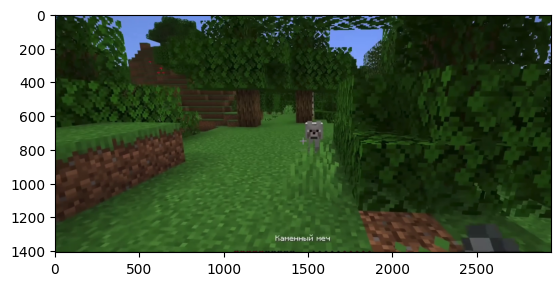

In [75]:
input_video_path='datasets/minecraft/video.mp4'
img_file='datasets/minecraft/video_frame_1.jpg'
#/content/onedl-mmdetection/artifacts/inference/fcos
output_video_path='artifacts/inference/fcos/video_out.mp4'
confidence_threshold=0.5
cap = cv2.VideoCapture(input_video_path)
success, frame = cap.read()

cap.release()
img_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
plt.imshow(img_rgb);

plt.savefig(img_file, dpi=300, bbox_inches='tight')

Output()

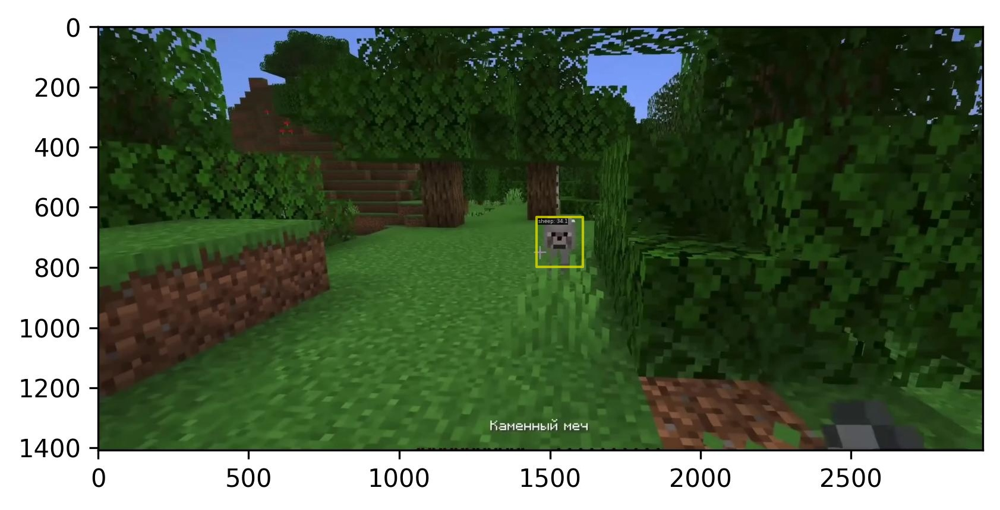

In [76]:
out_dir='artifacts/inference/fcos'
# Perform inference
img_path = 'datasets/minecraft/'
img_file='video_frame_1.jpg'
img=img_path + img_file

inferencer(img, out_dir=out_dir)
Image.open(out_dir + '/vis/' + img_file)

In [92]:
results = inference_detector(model, frame)
        # Получаем bboxes, scores и labels
bboxes = results.pred_instances.bboxes[0]
scores = results.pred_instances.scores[0:4]
labels = results.pred_instances.labels[0:4]
bboxes,scores,labels,[cls_names[l] for l in labels[0:4]]

(tensor([1471.0786,  637.9490, 1591.9152,  775.7217]),
 tensor([0.3159, 0.2829, 0.1181, 0.0723]),
 tensor([ 2, 12, 11,  3]),
 ['cow', 'skeleton', 'sheep', 'creeper'])

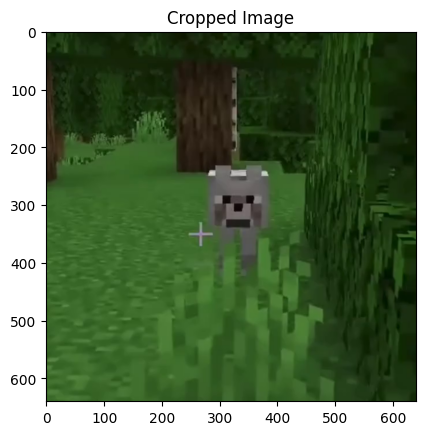

In [88]:
cropped_frame = frame[400:400+640, 1200:1200+640]
plt.title("Cropped Image")
plt.imshow(cropped_frame);

img_path = 'datasets/minecraft/'
img_file='video_frame_1_cropped.jpg'
img=img_path + img_file

img_rgb = cv2.cvtColor(cropped_frame, cv2.COLOR_BGR2RGB)
plt.imshow(img_rgb);

plt.savefig('datasets/minecraft/'+img_file, dpi=300, bbox_inches='tight')

Output()

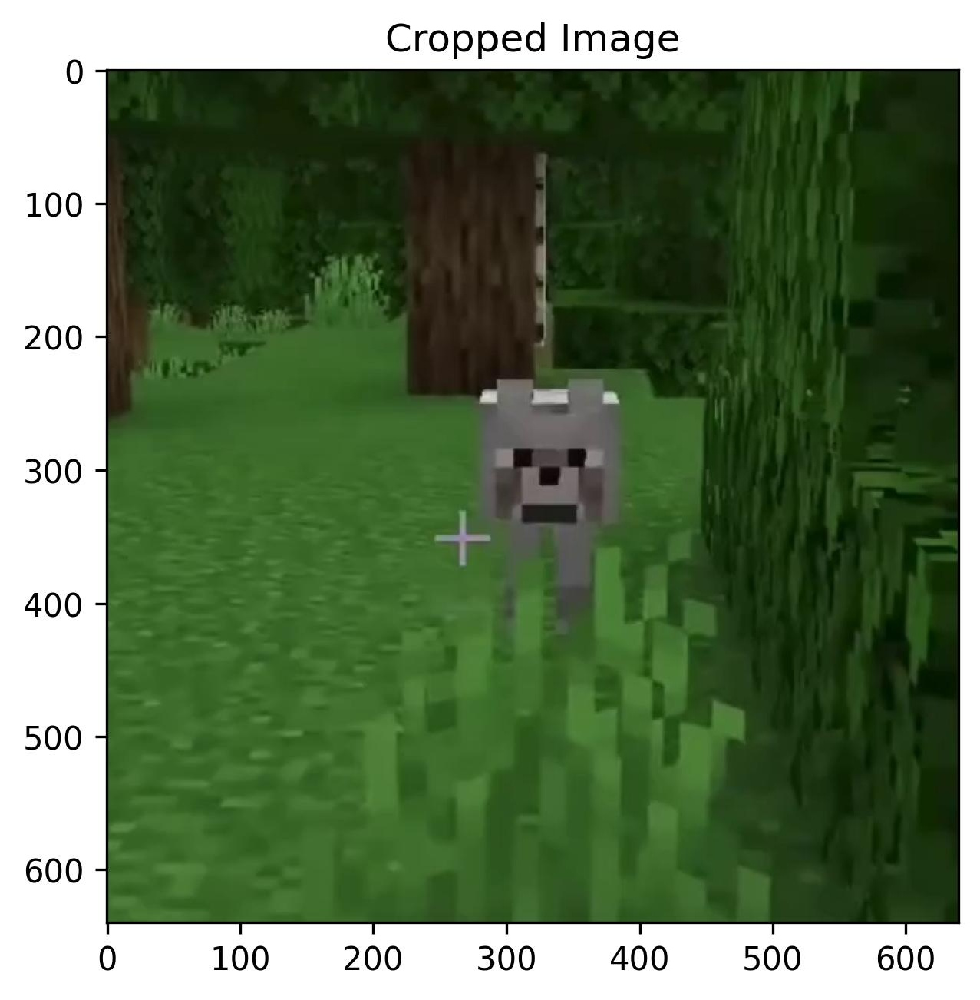

In [89]:
inferencer(img, out_dir=out_dir)
Image.open(out_dir + '/vis/' + img_file)

In [90]:
results = inference_detector(model, cropped_frame)
        # Получаем bboxes, scores и labels
bboxes = results.pred_instances.bboxes[0]
scores = results.pred_instances.scores[0:2]
labels = results.pred_instances.labels[0:2]
bboxes,scores,labels,[cls_names[l] for l in labels[0:2]]

(tensor([276.0302, 228.7158, 393.5129, 447.4766]),
 tensor([0.2247, 0.0888]),
 tensor([11, 15]),
 ['sheep', 'wolf'])

In [82]:
results = inference_detector(model, cropped_frame)
        # Получаем bboxes, scores и labels
bboxes = results.pred_instances.bboxes[0]
scores = results.pred_instances.scores[0]
labels = results.pred_instances.labels[0]
bboxes,scores,labels

(tensor([276.0302, 228.7158, 393.5129, 447.4766]), tensor(0.2247), tensor(11))

# Графики результатов обучения

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import os
import glob
from pathlib import Path
import re

def parse_fcos_log(log_path):
    """Парсит лог-файл FCOS и возвращает DataFrame"""
    train_data = []
    val_data = []

    with open(log_path, 'r') as f:
        lines = f.readlines()

    # Регулярные выражения для парсинга
    train_pattern = r'Epoch\(train\)\s+\[(\d+)\]\[.*?\]\s+lr:\s+([\d.e+-]+).*?loss:\s+([\d.]+)\s+loss_cls:\s+([\d.]+)\s+loss_bbox:\s+([\d.]+)\s+loss_centerness:\s+([\d.]+)'
    val_pattern = r'Epoch\(val\)\s+\[(\d+)\].*?coco/bbox_mAP:\s+([\d.]+)\s+coco/bbox_mAP_50:\s+([\d.]+)\s+coco/bbox_mAP_75:\s+([\d.]+)\s+coco/bbox_mAP_s:\s+([\d.]+)\s+coco/bbox_mAP_m:\s+([\d.]+)\s+coco/bbox_mAP_l:\s+([\d.]+)'

    for line in lines:
        # Парсим тренировочные данные
        train_match = re.search(train_pattern, line)
        if train_match:
            try:
                epoch = int(train_match.group(1))
                lr = float(train_match.group(2))
                loss = float(train_match.group(3))
                loss_cls = float(train_match.group(4))
                loss_bbox = float(train_match.group(5))
                loss_centerness = float(train_match.group(6))

                # Находим информацию о шаге
                step_match = re.search(r'\[(\d+)/(\d+)\]', line)
                if step_match:
                    step = int(step_match.group(1))
                    total_steps = int(step_match.group(2))
                    global_step = step + (epoch - 1) * total_steps
                else:
                    global_step = len(train_data) + 1

                train_data.append({
                    'step': global_step,
                    'epoch': epoch,
                    'loss': loss,
                    'loss_cls': loss_cls,
                    'loss_bbox': loss_bbox,
                    'loss_centerness': loss_centerness,
                    'lr': lr
                })
            except (ValueError, IndexError):
                continue

        # Парсим валидационные данные
        val_match = re.search(val_pattern, line)
        if val_match:
            try:
                epoch = int(val_match.group(1))
                mAP = float(val_match.group(2))
                mAP_50 = float(val_match.group(3))
                mAP_75 = float(val_match.group(4))
                mAP_s = float(val_match.group(5))
                mAP_m = float(val_match.group(6))
                mAP_l = float(val_match.group(7))

                val_data.append({
                    'epoch': epoch,
                    'mAP': mAP,
                    'mAP_50': mAP_50,
                    'mAP_75': mAP_75,
                    'mAP_s': mAP_s,
                    'mAP_m': mAP_m,
                    'mAP_l': mAP_l
                })
            except (ValueError, IndexError):
                continue

    # Создаем DataFrame
    train_df = pd.DataFrame(train_data)
    val_df = pd.DataFrame(val_data)

    # Удаляем дубликаты и сортируем
    if not train_df.empty:
        train_df = train_df.drop_duplicates(subset=['step']).sort_values('step')
    if not val_df.empty:
        val_df = val_df.drop_duplicates(subset=['epoch']).sort_values('epoch')

    return train_df, val_df


In [29]:
log_path='artifacts/metrics/fcos.log'
shutil.copyfile('/content/drive/MyDrive/fcos.log',log_path)

'artifacts/metrics/fcos.log'

In [31]:
train_df, val_df = parse_fcos_log(log_path)

print(f"Training records: {len(train_df)}")
print(f"Validation records: {len(val_df)}")


Training records: 276
Validation records: 12


In [ ]:
val_df

,epoch,mAP,mAP_50,mAP_75,mAP_s,mAP_m,mAP_l
0,1,0.145,0.389,0.063,0.024,0.112,0.186
1,2,0.222,0.508,0.157,0.018,0.166,0.316
2,3,0.304,0.607,0.280,0.055,0.241,0.408
3,4,0.342,0.683,0.288,0.056,0.273,0.451
4,5,0.385,0.699,0.371,0.063,0.339,0.518
5,6,0.439,0.748,0.459,0.080,0.363,0.581
6,7,0.407,0.758,0.396,0.075,0.373,0.521
7,8,0.446,0.758,0.486,0.082,0.379,0.575
8,9,0.491,0.799,0.529,0.086,0.433,0.624
9,10,0.501,0.803,0.544,0.093,0.448,0.630


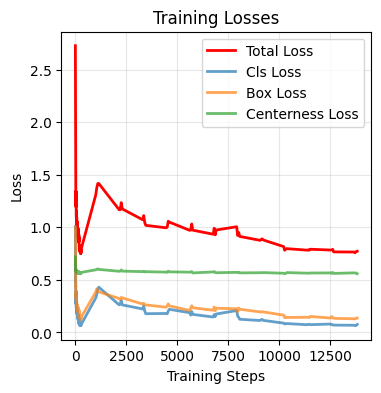

In [32]:
plt.figure(figsize=(4, 4))
plt.plot(train_df['step'], train_df['loss'], label='Total Loss', linewidth=2, color='red')
plt.plot(train_df['step'], train_df['loss_cls'], label='Cls Loss', linewidth=2, alpha=0.7)
plt.plot(train_df['step'], train_df['loss_bbox'], label='Box Loss', linewidth=2, alpha=0.7)
plt.plot(train_df['step'], train_df['loss_centerness'], label='Centerness Loss', linewidth=2, alpha=0.7)

plt.title('Training Losses')
plt.xlabel('Training Steps')
plt.ylabel('Loss')
plt.grid(True, alpha=0.3)
plt.legend();


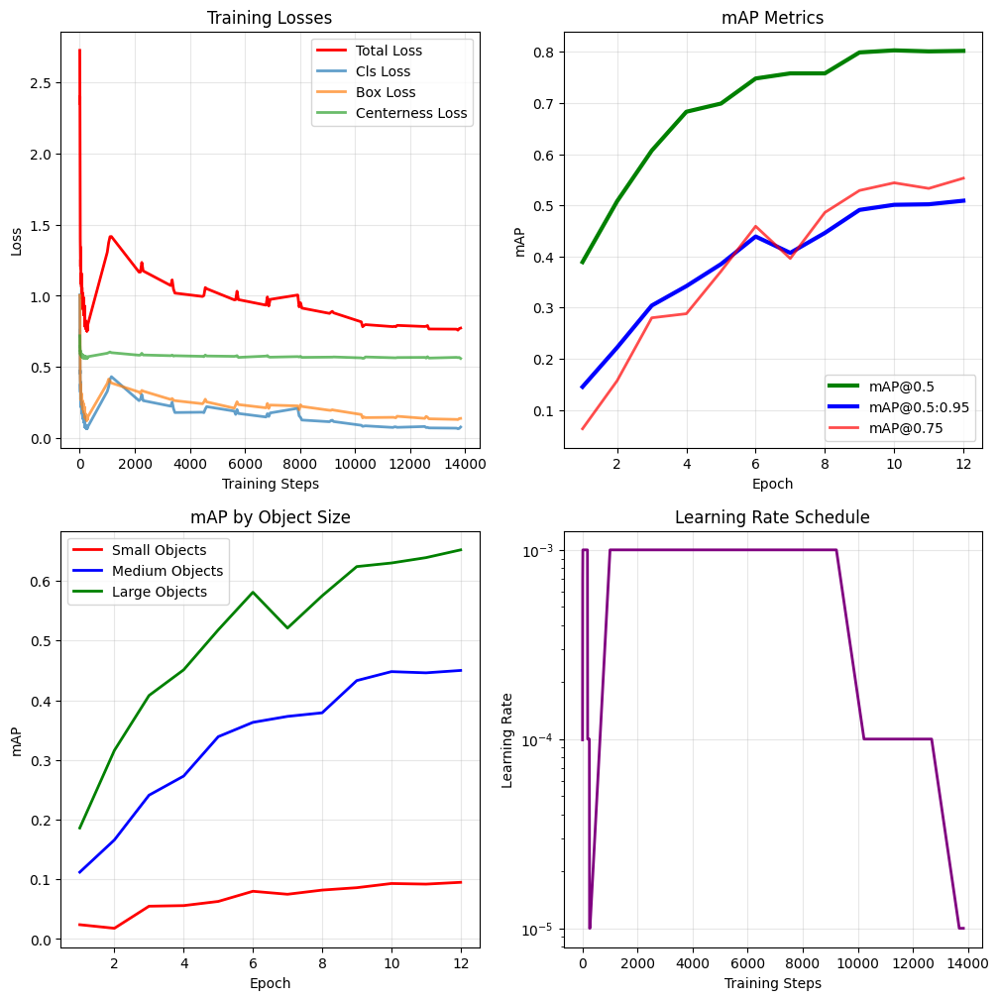

In [33]:
if train_df.empty or val_df.empty:
        print("Not enough data for visualization")
else:
        fig, axes = plt.subplots(2, 2, figsize=(12, 12))
        #fig.suptitle(f'FCOS Training Analysis - {dir_name}', fontsize=16, fontweight='bold')

        # 1. График потерь обучения
        axes[0, 0].plot(train_df['step'], train_df['loss'], label='Total Loss', linewidth=2, color='red')
        axes[0, 0].plot(train_df['step'], train_df['loss_cls'], label='Cls Loss', linewidth=2, alpha=0.7)
        axes[0, 0].plot(train_df['step'], train_df['loss_bbox'], label='Box Loss', linewidth=2, alpha=0.7)
        axes[0, 0].plot(train_df['step'], train_df['loss_centerness'], label='Centerness Loss', linewidth=2, alpha=0.7)
        axes[0, 0].set_title('Training Losses')
        axes[0, 0].set_xlabel('Training Steps')
        axes[0, 0].set_ylabel('Loss')
        axes[0, 0].legend()
        axes[0, 0].grid(True, alpha=0.3)

        # 2. График метрик mAP
        axes[0, 1].plot(val_df['epoch'], val_df['mAP_50'], label='mAP@0.5', linewidth=3, color='green')
        axes[0, 1].plot(val_df['epoch'], val_df['mAP'], label='mAP@0.5:0.95', linewidth=3, color='blue')
        axes[0, 1].plot(val_df['epoch'], val_df['mAP_75'], label='mAP@0.75', linewidth=2, color='red', alpha=0.7)
        axes[0, 1].set_title('mAP Metrics')
        axes[0, 1].set_xlabel('Epoch')
        axes[0, 1].set_ylabel('mAP')
        axes[0, 1].legend()
        axes[0, 1].grid(True, alpha=0.3)

        # 3. График mAP по размерам объектов
        axes[1, 0].plot(val_df['epoch'], val_df['mAP_s'], label='Small Objects', linewidth=2, color='red')
        axes[1, 0].plot(val_df['epoch'], val_df['mAP_m'], label='Medium Objects', linewidth=2, color='blue')
        axes[1, 0].plot(val_df['epoch'], val_df['mAP_l'], label='Large Objects', linewidth=2, color='green')
        axes[1, 0].set_title('mAP by Object Size')
        axes[1, 0].set_xlabel('Epoch')
        axes[1, 0].set_ylabel('mAP')
        axes[1, 0].legend()
        axes[1, 0].grid(True, alpha=0.3)

        # 4. График Learning Rate
        axes[1, 1].plot(train_df['step'], train_df['lr'], label='Learning Rate', linewidth=2, color='purple')
        axes[1, 1].set_title('Learning Rate Schedule')
        axes[1, 1].set_xlabel('Training Steps')
        axes[1, 1].set_ylabel('Learning Rate')
        axes[1, 1].set_yscale('log')
        axes[1, 1].grid(True, alpha=0.3)

        plt.savefig('artifacts/metrics/metrics_fcos.png', dpi=300, bbox_inches='tight')

Возьмем метрики из выдачи:

 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.509

 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.802

 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.553

 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.095

 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.450

 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.652

 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.588

 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.588

 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.588

 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.190

 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.529

 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.715


In [ ]:
Precision= 0.354
Recall= 0.310
#        F1= 0.331,
Precision= 0.751
Recall= 0.495
#        'F1-score': 0.596,

F1=2*(Precision*Recall)/(Precision+Recall)
F1

0.596701444622793

Метрики из выдачи YOLO:

Ultralytics 8.3.227 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)

Model summary (fused): 72 layers, 3,008,963 parameters, 0 gradients, 8.1 GFLOPs

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 27/27 4.2it/s 6.4s

                   all        432        763      0.904      0.804       0.88      0.645
                   bee         13         14      0.916      0.857      0.916      0.516
               chicken         74        127       0.94      0.866      0.925      0.668
                   cow         50        114      0.865      0.846      0.942      0.654
               creeper         36         43      0.937      0.907      0.945      0.721
              enderman         23         23      0.976      0.913      0.961      0.726
                   fox         15         15      0.675      0.533      0.519       0.28
                  frog         15         17      0.906      0.765      0.891      0.597
                 ghast         17         19      0.831      0.947      0.958      0.868
                  goat         14         15      0.902      0.615      0.833      0.623
                 llama         21         22      0.851      0.864      0.912      0.768
                   pig         80        190      0.904      0.846      0.907      0.623
                 sheep         22         41      0.905      0.683       0.77      0.527
              skeleton         25         26      0.983      0.808      0.932      0.678
                spider         26         26      0.952      0.808      0.931       0.77
                turtle         21         23      0.943      0.957      0.992      0.713
                  wolf         12         20      0.876      0.708       0.77      0.536
                zombie         25         28          1      0.737      0.863      0.701

Speed: 0.4ms preprocess, 2.5ms inference, 0.0ms loss, 3.2ms postprocess per image

Results saved to /content/runs/detect/minecraft_yolov8n_run3

Обучение завершено. Результаты сохранены в папке: /content/runs/detect/minecraft_yolov8n_run3

ИНТЕРПРЕТАЦИЯ РЕЗУЛЬТАТОВ:

mAP > 0.5: Отличная производительность,

Precision > 0.7: Высокая точность обнаружений

Recall > 0.5: Хорошее покрытие объектов

FPS > 30: Подходит для real-time обработки
